In [55]:
source("R/simulation.R")
source("R/deconvolution.R")

In [56]:
GSE19830.em <- ExpressionMix("GSE19830", verbose=TRUE)
GSE19830.mix <- CellMix::mixedSamples(GSE19830.em)
GSE19830.props.true <- coef(GSE19830.mix)
data <- exprs(GSE19830.em)
cell_types <- 3
top_genes = 4000
global_iterations = 2000
coef_hinge_H = 0
coef_hinge_W = 0
coef_pos_D_h = 0
coef_pos_D_w = 0
coef_der_X = 0.00001
coef_der_Omega = 0.0000001
scaling_iterations = 20
seed = 42
init_centered = TRUE

Loading dataset 'GSE19830' ... OK


In [15]:
lo2 <- SinkhornNNLSLinseed$new(
    dataset = data,
    path = "linseed2_results",
    analysis_name = "deconv_comparison_2",
    cell_types = cell_types,
    global_iterations = global_iterations,
    coef_der_X = coef_der_X,
    coef_der_Omega = coef_der_Omega,
    coef_pos_D_h = coef_pos_D_h,
    coef_pos_D_w = coef_pos_D_w,
    coef_hinge_H = coef_hinge_H,
    coef_hinge_W = coef_hinge_W
)

In [16]:
lo2$selectTopGenes(500)

In [17]:
lo2$scaleDataset(iterations = scaling_iterations)

In [32]:
all(1 - rowSums(lo2$V_row) < 0.0000001)

[1] TRUE

In [33]:
all(1 - colSums(lo2$V_column) < 0.0000001)

[1] TRUE

In [45]:
dim(lo2$V_row) # M x N

[1] 500  42

In [44]:
dim(lo2$V_column) # M x N

[1] 500  42

In [47]:
lo2$getSvdProjectionsNew()

In [53]:
install.packages("rgl")


  There is a binary version available but the source version is later:
      binary  source needs_compilation
rgl 0.100.50 0.109.2              TRUE



installing the source package ‘rgl’




In [54]:
lo2$

NULL

In [248]:
source("R/simulation.R")
source("R/deconvolution.R")
source("R/docker_linseed_pipeline/LinseedMetadata.R")
source("R/docker_linseed_pipeline/SinkhornNNLSLinseedC.R")
Rcpp::sourceCpp("R/docker_linseed_pipeline/pipeline.cpp")

In [2]:
options(repr.plot.width=16, repr.plot.height=8)

In [175]:
library('gridExtra')

In [313]:
trainLinseed2 <- function(
    data,
    cell_types,
    top_genes = 4000,
    global_iterations = 2000,
    coef_hinge_H = 0,
    coef_hinge_W = 0,
    coef_pos_D_h = 0,
    coef_pos_D_w = 0,
    coef_der_X = 0.00001,
    coef_der_Omega = 0.0000001,
    scaling_iterations = 20,
    seed = 42,
    init_centered = TRUE
) {
    lo2 <- SinkhornNNLSLinseed$new(
        dataset = data,
        path = "linseed2_results",
        analysis_name = "deconv_comparison_2",
        cell_types = cell_types,
        global_iterations = global_iterations,
        coef_der_X = coef_der_X,
        coef_der_Omega = coef_der_Omega,
        coef_pos_D_h = coef_pos_D_h,
        coef_pos_D_w = coef_pos_D_w,
        coef_hinge_H = coef_hinge_H,
        coef_hinge_W = coef_hinge_W
    )
    
    lo2$selectTopGenes(top_genes)

    print("Scale dataset")
    lo2$scaleDataset(iterations = scaling_iterations)

    print("Get SVD projections")
    lo2$getSvdProjectionsNew(k = cell_types)

    print("Find initial points")
    if (init_centered) {
        lo2$selectInitRandomCentered(seed=seed)
    } else {
        lo2$selectInitRandom(seed=seed)
    }

    print("Run optimization")
    lo2$runOptimization()

    lo2
}

# GSE19830

In [4]:
GSE19830.em <- ExpressionMix("GSE19830", verbose=TRUE)
GSE19830.mix <- CellMix::mixedSamples(GSE19830.em)
GSE19830.props.true <- coef(GSE19830.mix)

Loading dataset 'GSE19830' ... OK


## Triangle trajectories live

In [288]:
ggplot(df, aes(x = Y, y = Z)) +
    geom_polygon(fill = NA, color = "green") +
    theme_minimal() +
    gganimate::transition_time(iteration)

ERROR while rich displaying an object: Error in transform_polygon(all_frames, states[[i]], ease, nframes[i], : transformr is required to tween polygons

Traceback:
1. tryCatch(withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     prepare_content(is.raw(rpr), rpr)
 . }, error = error_handler), error = outer_handler)
2. tryCatchList(expr, classes, parentenv, handlers)
3. tryCatchOne(expr, names, parentenv, handlers[[1L]])
4. doTryCatch(return(expr), name, parentenv, handler)
5. withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     prepare_content(is.raw(rpr), rpr)
 . }, error = error_handler)
6. repr::mime2repr[[mime]](o

In [ ]:
df <- as.data.frame(lo2$points_statistics_X)
colnames(df) <- c("X_1", "Y_1", "Z_1", "X_2", "Y_2", "Z_2", "X_3", "Y_3", "Z_3")
df

In [330]:
df <- as.data.frame(lo2$points_statistics_X)
colnames(df) <- c("X_1", "Y_1", "Z_1", "X_2", "Y_2", "Z_2", "X_3", "Y_3", "Z_3")
df <- reshape(df, varying = 1:9, sep = "_", direction = 'long')
colnames(df) <- c("point", "X", "Y", "Z", "iteration")
df <- df[order(df$point, df$iteration),]
df$diff_X <- c(0, diff(df$X))
df$diff_Y <- c(0, diff(df$Y))
df$diff_Z <- c(0, diff(df$Z))
df[order(df$iteration),]

,point,X,Y,Z,iteration,diff_X,diff_Y,diff_Z
,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<dbl>
1.1,1,0.1740777,0.006837158,-0.11236639,1,0.000000e+00,0.000000e+00,0.000000e+00
1.2,2,0.1740777,0.002843239,0.05927466,1,1.110223e-16,1.738363e-01,9.588593e-02
1.3,3,0.1740777,-0.009680397,0.05309173,1,2.775558e-17,-1.462004e-01,1.897096e-01
2.1,1,0.1740777,-0.002408101,-0.10866415,2,0.000000e+00,-9.245259e-03,3.702242e-03
2.2,2,0.1740777,0.003282453,0.05903163,2,0.000000e+00,4.392134e-04,-2.430326e-04
2.3,3,0.1740777,0.001086735,0.04725981,2,0.000000e+00,1.076713e-02,-5.831921e-03
3.1,1,0.1740777,-0.013170742,-0.10276443,3,0.000000e+00,-1.076264e-02,5.899720e-03
3.2,2,0.1740777,0.010246052,0.05526928,3,0.000000e+00,6.963599e-03,-3.762350e-03
3.3,3,0.1740777,0.004243279,0.04576971,3,0.000000e+00,3.156544e-03,-1.490094e-03


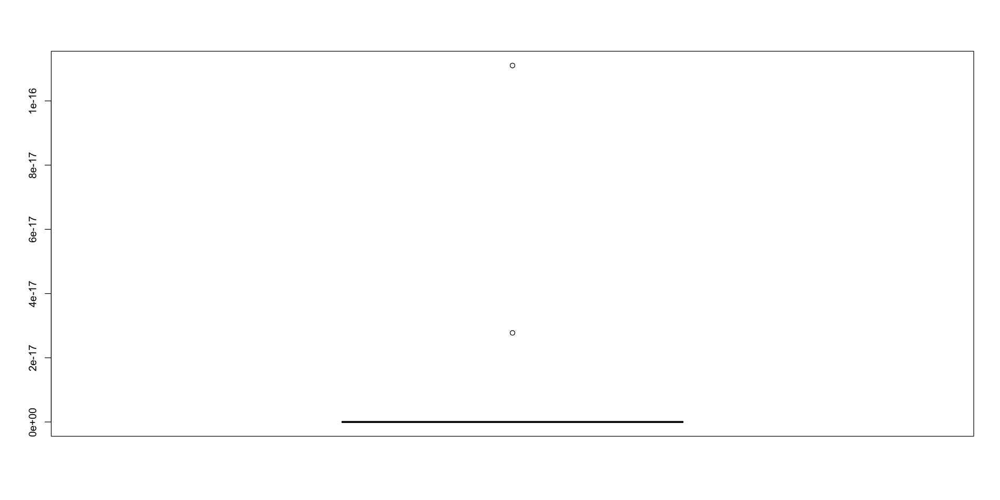

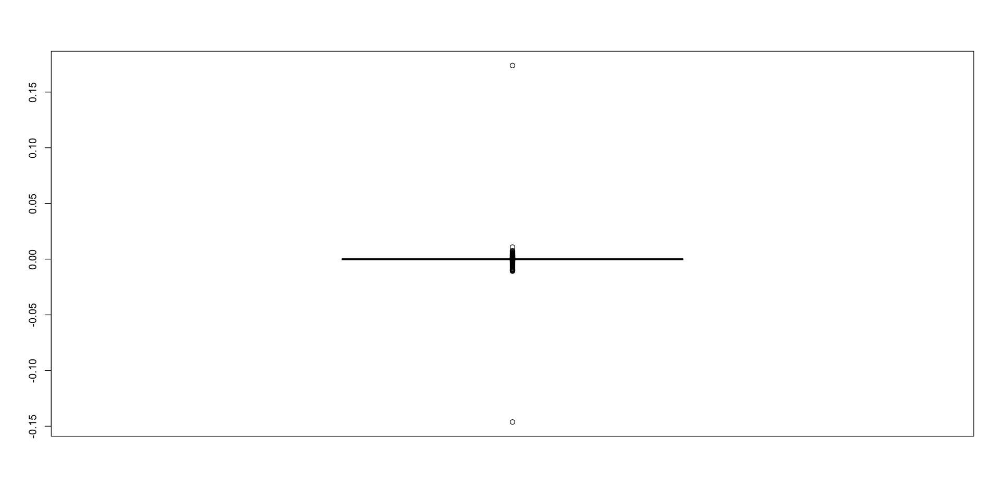

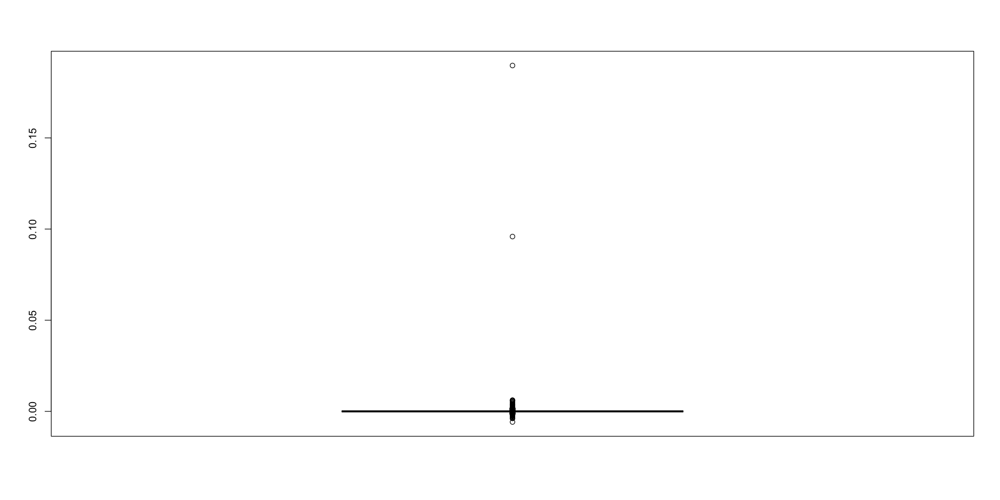

In [329]:
boxplot(df$diff_X)
boxplot(df$diff_Y)
boxplot(df$diff_Z)

## Triangle trajectories

In [314]:
lo2 <- trainLinseed2(exprs(GSE19830.mix), 3, 2000, top_genes = 493)

[1] "Scale dataset"



Scaling dataset [======>---------------------]  25% eta:  1s

Scaling dataset [=======>--------------------]  30% eta:  1s

Scaling dataset [=========>------------------]  35% eta:  1s

Scaling dataset [==========>-----------------]  40% eta:  1s

Scaling dataset [============>---------------]  45% eta:  1s

Scaling dataset [=============>--------------]  50% eta:  1s

Scaling dataset [==============>-------------]  55% eta:  1s

Scaling dataset [================>-----------]  60% eta:  1s

Scaling dataset [=================>----------]  65% eta:  0s

Scaling dataset [===================>--------]  70% eta:  0s

Scaling dataset [====================>-------]  75% eta:  0s

Scaling dataset [=====================>------]  80% eta:  0s

Scaling dataset [=======================>----]  85% eta:  0s

Scaling dataset [========================>---]  90% eta:  0s

Scaling dataset [==========================>-]  95% eta:  0s

Scaling dataset [============================] 100% eta:  0s




[1] "Get SVD projections"
[1] "Find initial points"
[1] "Run optimization"


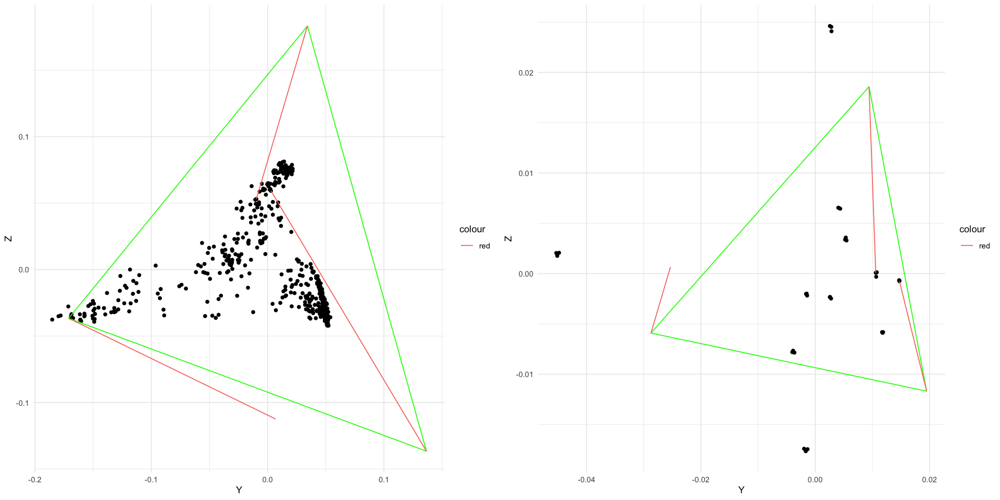

In [319]:
X <- lo2$X
Omega <- lo2$Omega
dims <- 3
prev_iteration <- 1
iteration <- 4001

cur_it_X <- as.data.frame(t(matrix(lo2$points_statistics_X[iteration, ], nrow = dims, ncol = dims)))
prev_it_X <- as.data.frame(t(matrix(lo2$points_statistics_X[prev_iteration, ], nrow = dims, ncol = dims)))
two_its_X <- rbind(cur_it_X, prev_it_X)
colnames(two_its_X) <- c("X", "Y", "Z")
two_its_X$point <- rep(1:dims, 2)
two_its_X$iter <- rep(1:2, each=dims)
toPlot <- as.data.frame(lo2$V_row %*% t(lo2$R))[, 1:dims]
colnames(toPlot) <- c("X", "Y", "Z")
pltX <- ggplot(toPlot, aes(x = Y, y = Z)) +
    geom_point() +
    geom_polygon(data = two_its_X %>% filter(iter == 1), fill = NA, color = "green") +
    geom_line(data = two_its_X, aes(x = Y, y = Z, color = "red", group = point)) +
    theme_minimal()

cur_it_Omega <- as.data.frame(matrix(lo2$points_statistics_Omega[iteration, ], nrow = dims, ncol = dims))
prev_it_Omega <- as.data.frame(matrix(lo2$points_statistics_Omega[prev_iteration, ], nrow = dims, ncol = dims))
two_its_Omega <- rbind(cur_it_Omega, prev_it_Omega)
colnames(two_its_Omega) <- c("X", "Y", "Z")
two_its_Omega$point <- rep(1:dims, 2)
two_its_Omega$iter <- rep(1:2, each=dims)
toPlot <- as.data.frame(t(lo2$S %*% lo2$V_column))[, 1:dims]
colnames(toPlot) <- c("X", "Y", "Z")
pltOmega <- ggplot(toPlot, aes(x = Y, y = Z)) +
    geom_point() +
    geom_polygon(data = two_its_Omega %>% filter(iter == 1), fill = NA, color = "green") +
    geom_line(data = two_its_Omega, aes(x = Y, y = Z, color = "red", group = point)) +
    theme_minimal()
grid.arrange(pltX, pltOmega, nrow = 1)

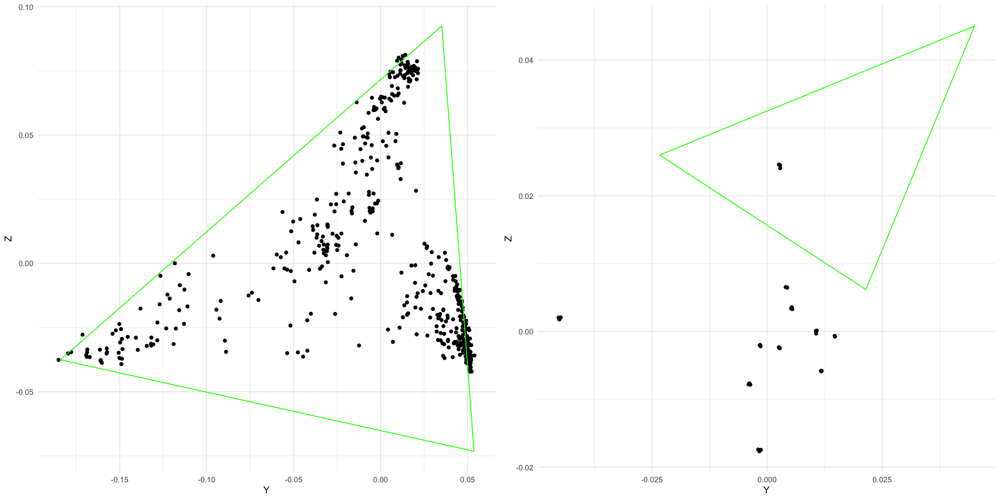

In [291]:
lo2$plotPoints2D(points="iteration", iteration = 2000)

## Error trajectories

In [317]:
trainAndVisualizeLinseed2 <- function(global_iterations, ...) {
    GSE19830.lo2 <- trainLinseed2(exprs(GSE19830.mix), 3, global_iterations, ...)

    tmp <- GSE19830.lo2$full_proportions
    GSE19830.props.lo2 <- tmp[guessOrder(tmp, GSE19830.props.true),]
    colnames(GSE19830.props.lo2) <- colnames(GSE19830.props.true)
    rownames(GSE19830.props.lo2) <- rownames(GSE19830.props.true)

    GSE19830.lo2$errors_statistics <- cbind(GSE19830.lo2$errors_statistics, iteration = seq_len(global_iterations * 2 + 1))
    show(GSE19830.lo2$plotErrors() + facet_wrap(facets = "variable", scales = "free"))
    
    show(plotProportions(GSE19830.props.true, GSE19830.props.lo2, pnames = c("ground truth", "linseed 2")))
    GSE19830.lo2$plotPoints2D(points="current")
    GSE19830.lo2$plotPoints2D(points="init")
    GSE19830.lo2$plotPoints2D(points="iteration", iteration = global_iterations %/% 2)
    
    GSE19830.lo2$calculateDistances()
    GSE19830.lo2$plotDistances()
}

Warning message in melt(toPlot, id.vars = "iteration", measure.vars = variables):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(toPlot). In the next version, this warning will become an error.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


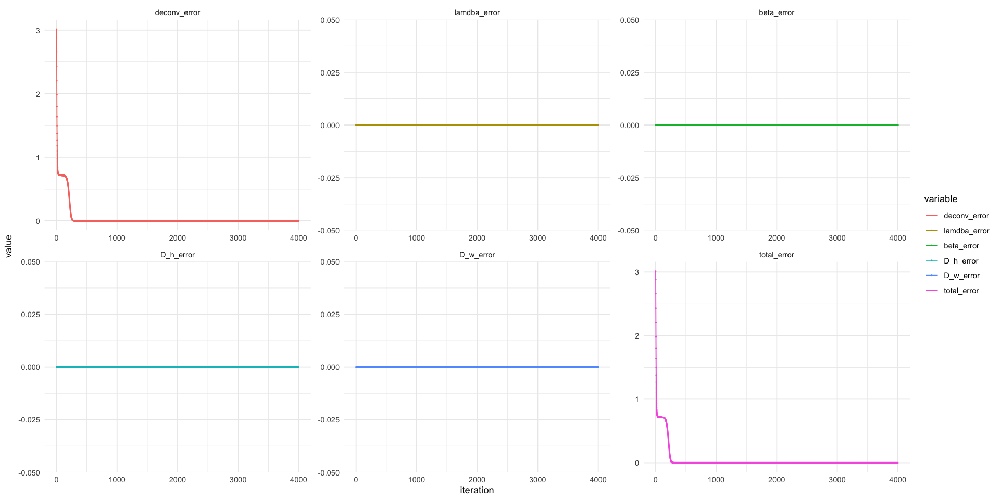

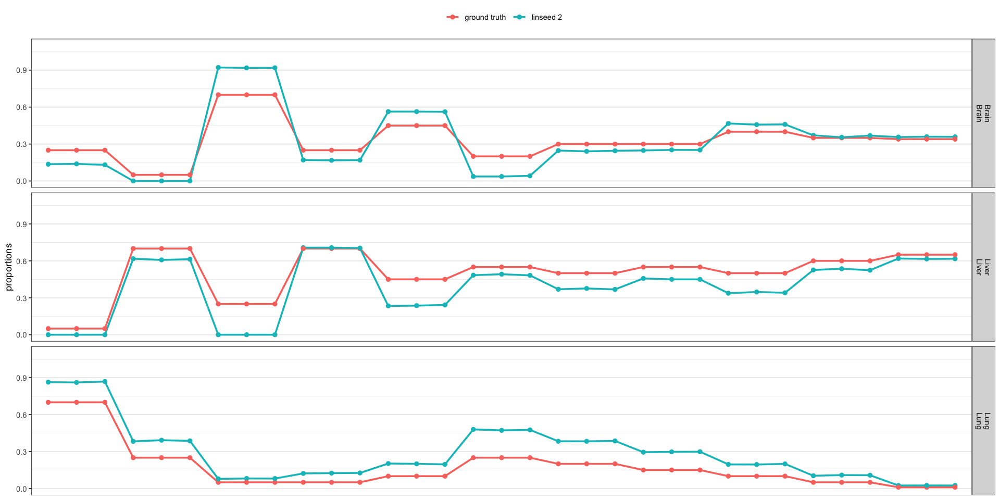

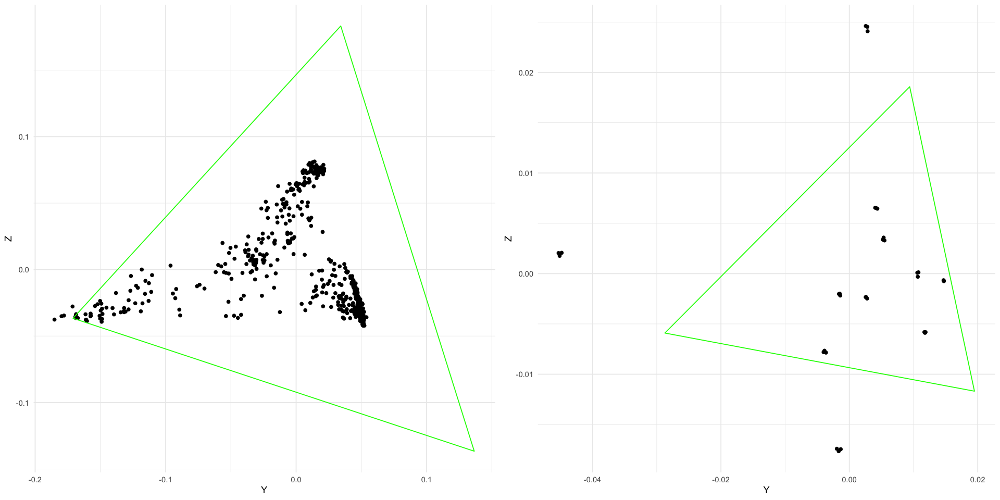

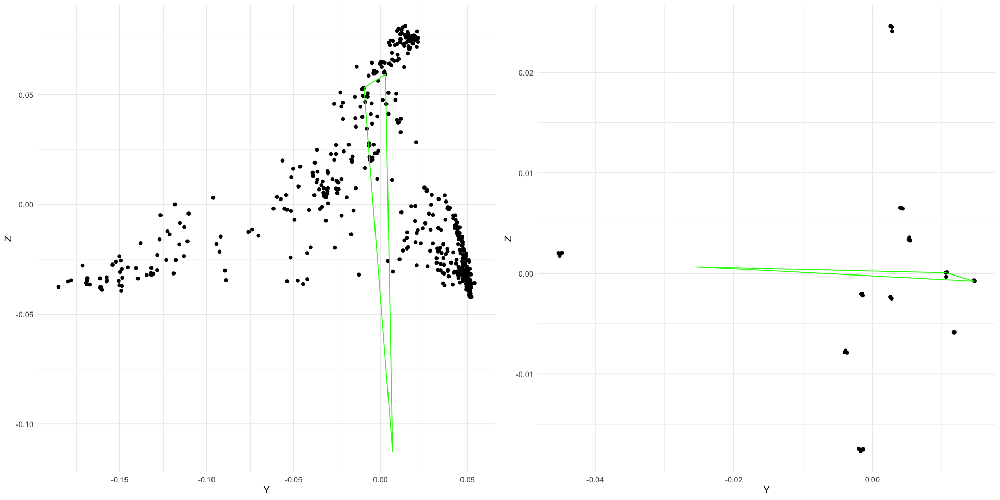

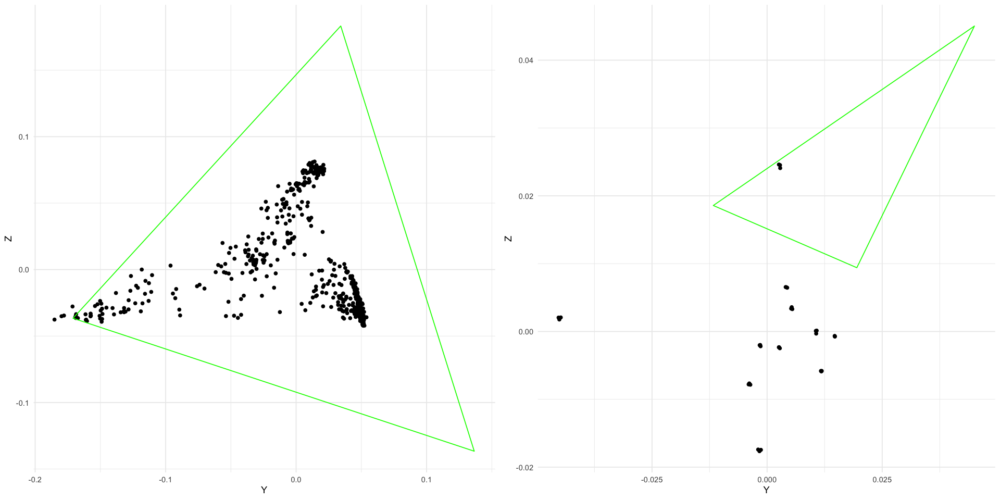

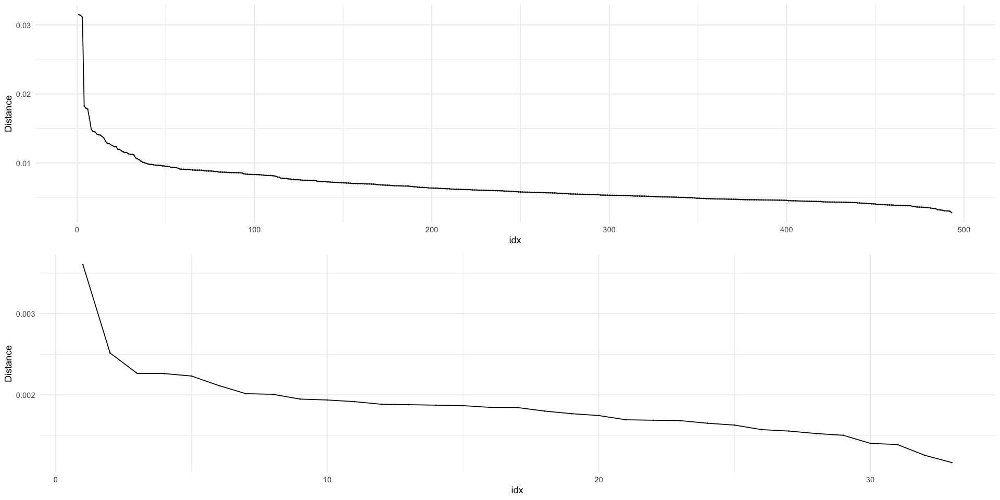

In [318]:
trainAndVisualizeLinseed2(global_iterations = 2000, top_genes = 493)

[1] "Scale dataset"
[1] "Get SVD projections"
[1] "Find initial points"
[1] "Run optimization"


Warning message in melt(toPlot, id.vars = "iteration", measure.vars = variables):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(toPlot). In the next version, this warning will become an error.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


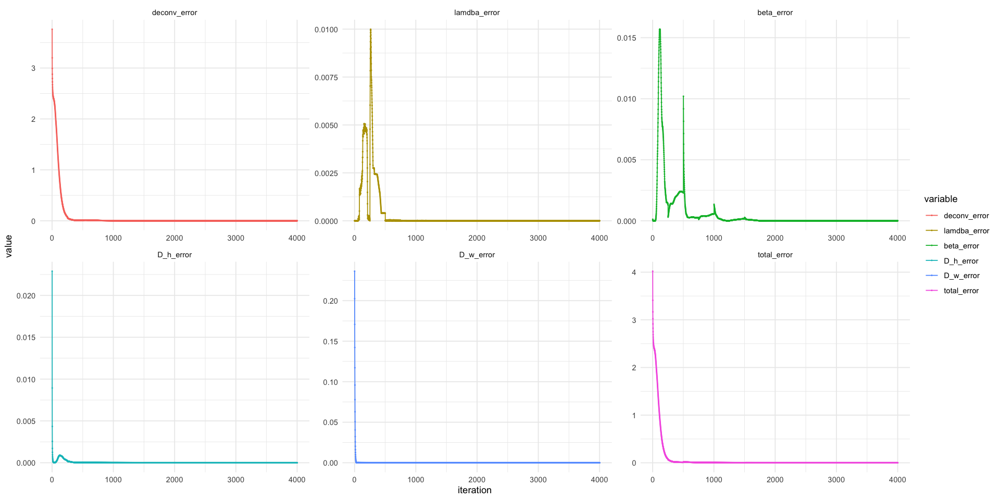

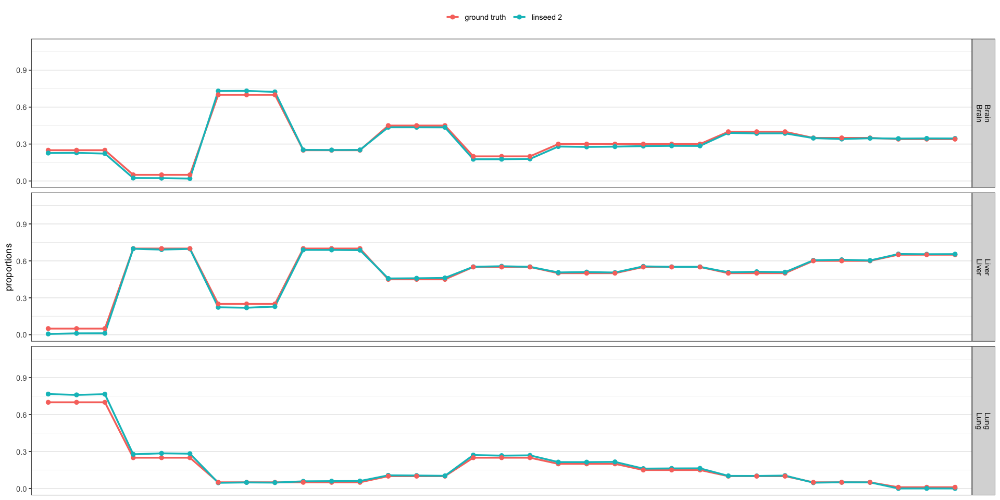

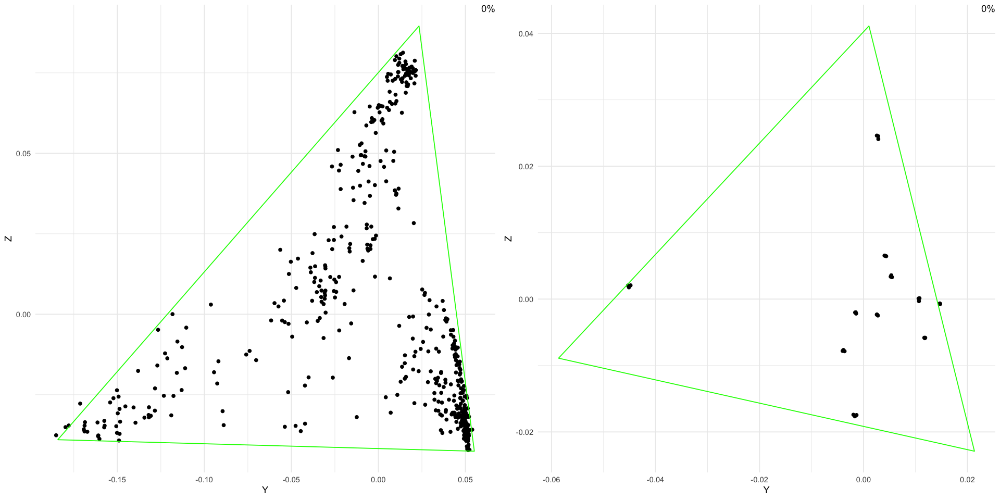

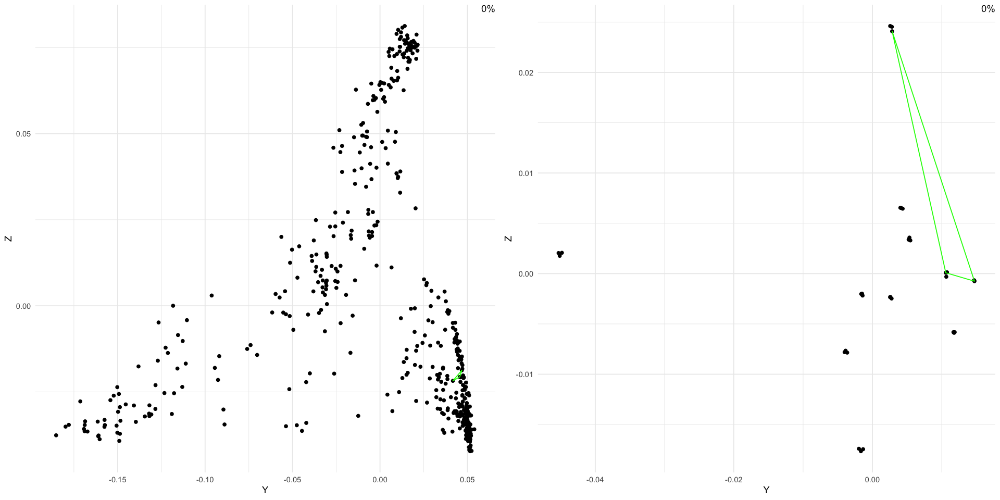

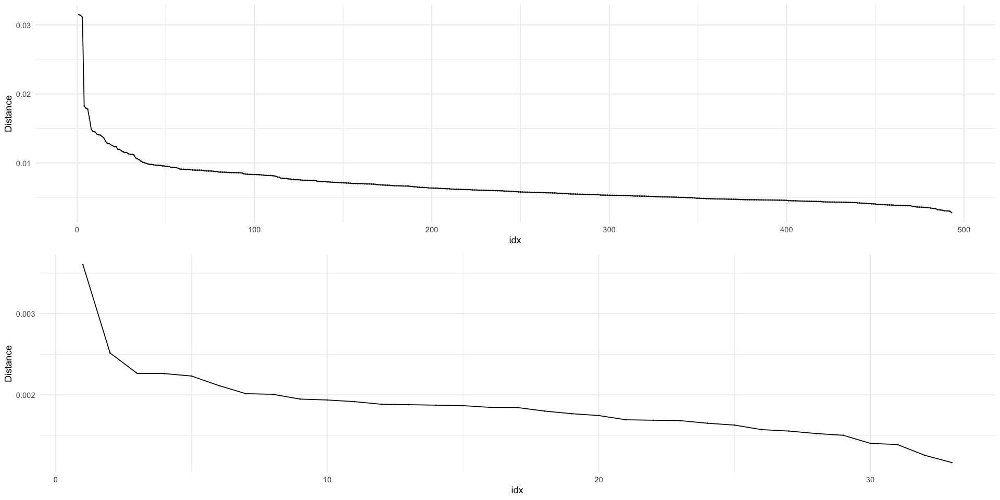

In [43]:
trainAndVisualizeLinseed2(global_iterations = 2000, top_genes = 493, init_centered = FALSE)

[1] "Scale dataset"



Scaling dataset [===>------------------------]  15% eta:  1s

Scaling dataset [=====>----------------------]  20% eta:  1s

Scaling dataset [======>---------------------]  25% eta:  1s

Scaling dataset [=======>--------------------]  30% eta:  1s

Scaling dataset [=========>------------------]  35% eta:  1s

Scaling dataset [==========>-----------------]  40% eta:  2s

Scaling dataset [============>---------------]  45% eta:  2s

Scaling dataset [=============>--------------]  50% eta:  1s

Scaling dataset [==============>-------------]  55% eta:  1s

Scaling dataset [================>-----------]  60% eta:  1s

Scaling dataset [=================>----------]  65% eta:  1s

Scaling dataset [===================>--------]  70% eta:  1s

Scaling dataset [====================>-------]  75% eta:  1s

Scaling dataset [=====================>------]  80% eta:  1s

Scaling dataset [=======================>----]  85% eta:  0s

Scaling dataset [========================>---]  90% eta:  0s

Scaling

[1] "Get SVD projections"
[1] "Find initial points"
[1] "Run optimization"


Warning message in melt(toPlot, id.vars = "iteration", measure.vars = variables):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(toPlot). In the next version, this warning will become an error.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


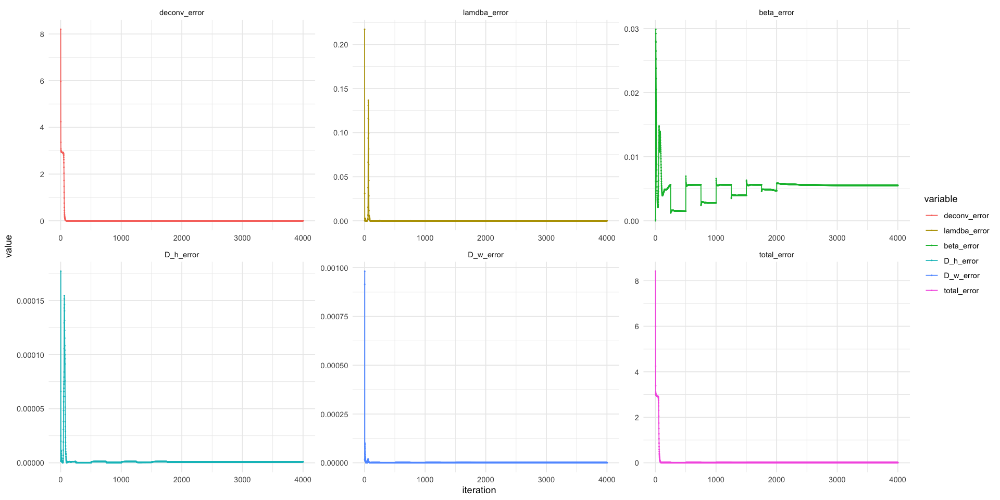

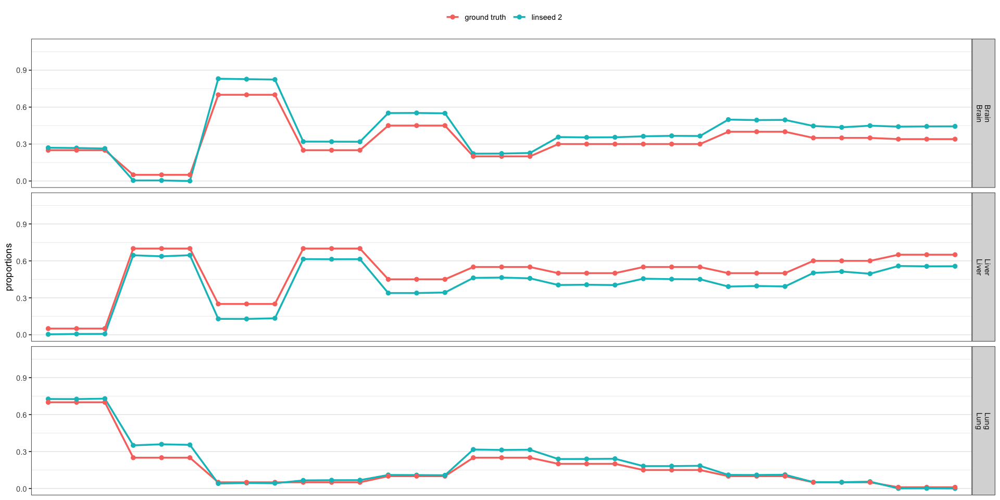

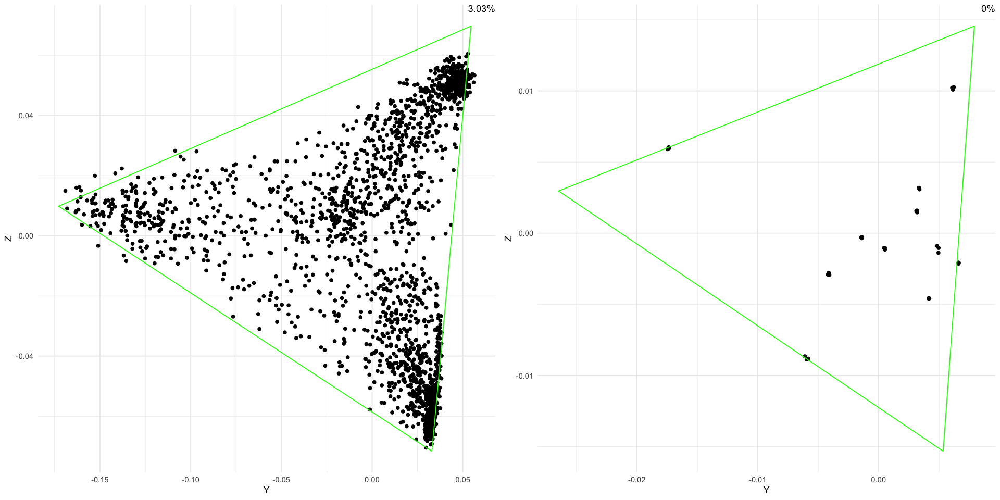

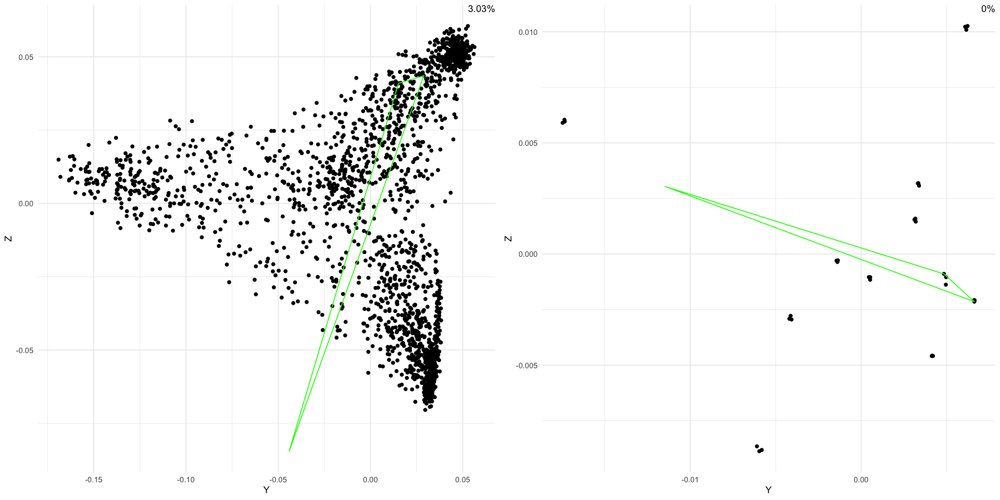

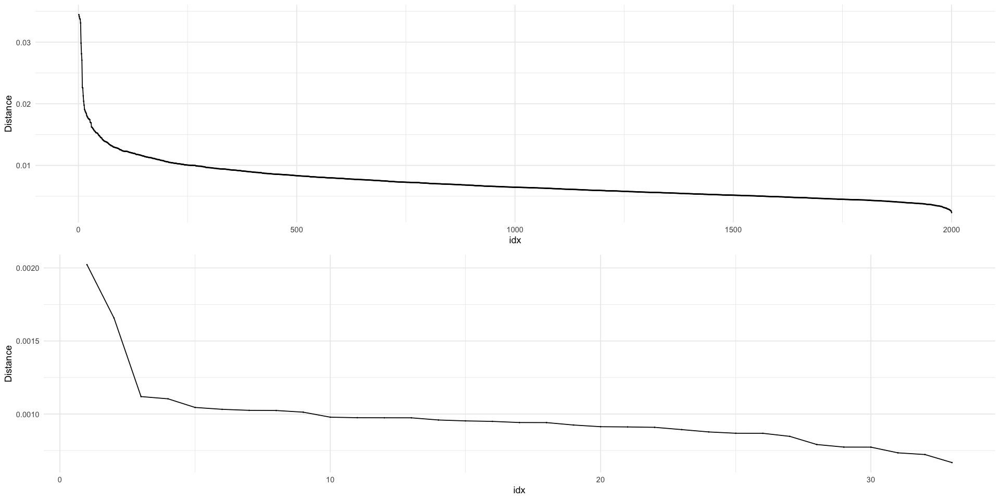

In [44]:
trainAndVisualizeLinseed2(global_iterations = 2000, top_genes = 2000)

[1] "Scale dataset"



Scaling dataset [===>------------------------]  15% eta:  1s

Scaling dataset [=====>----------------------]  20% eta:  1s

Scaling dataset [======>---------------------]  25% eta:  1s

Scaling dataset [=======>--------------------]  30% eta:  1s

Scaling dataset [=========>------------------]  35% eta:  1s

Scaling dataset [==========>-----------------]  40% eta:  1s

Scaling dataset [============>---------------]  45% eta:  1s

Scaling dataset [=============>--------------]  50% eta:  1s

Scaling dataset [==============>-------------]  55% eta:  1s

Scaling dataset [================>-----------]  60% eta:  1s

Scaling dataset [=================>----------]  65% eta:  1s

Scaling dataset [===================>--------]  70% eta:  1s

Scaling dataset [====================>-------]  75% eta:  1s

Scaling dataset [=====================>------]  80% eta:  0s

Scaling dataset [=======================>----]  85% eta:  0s

Scaling dataset [========================>---]  90% eta:  0s

Scaling

[1] "Get SVD projections"
[1] "Find initial points"
[1] "Run optimization"


Warning message in melt(toPlot, id.vars = "iteration", measure.vars = variables):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(toPlot). In the next version, this warning will become an error.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


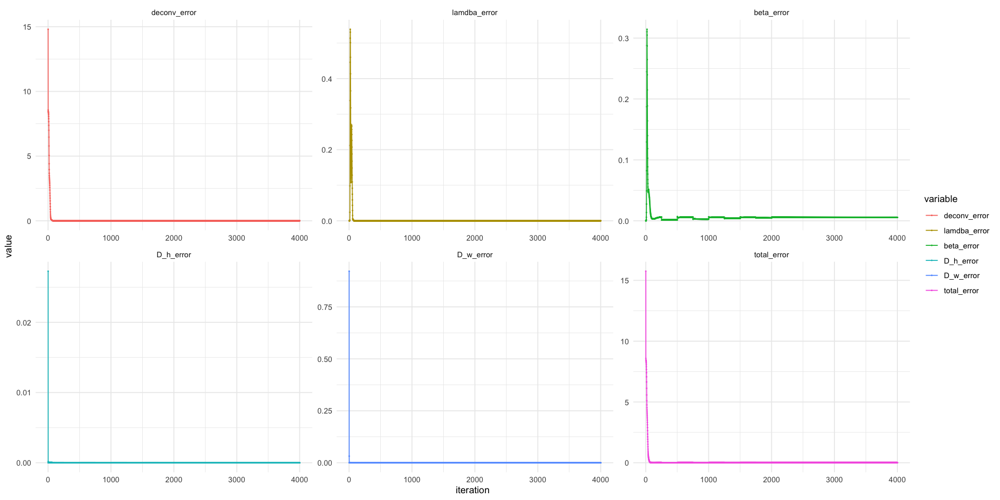

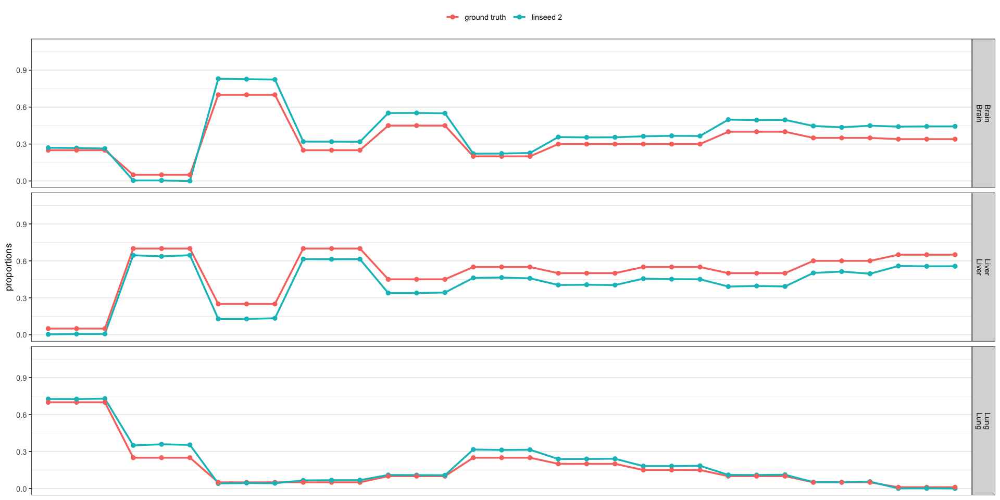

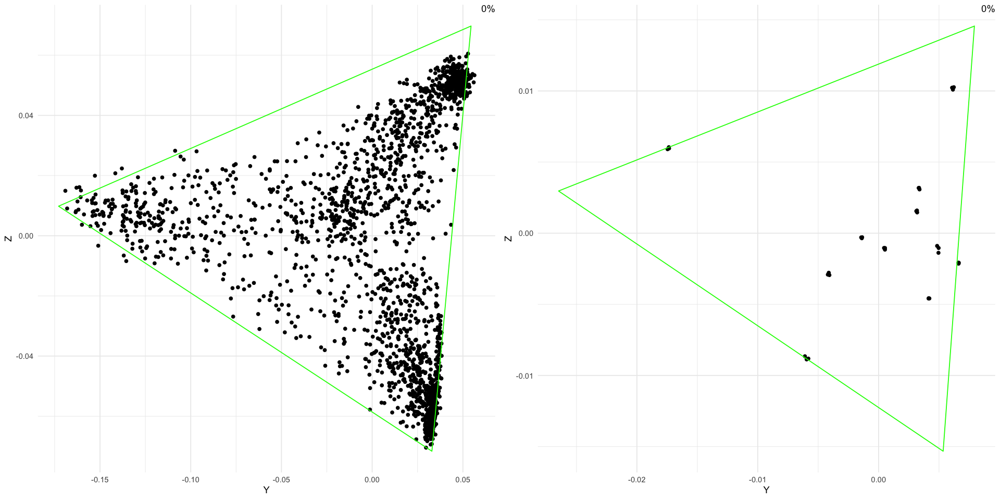

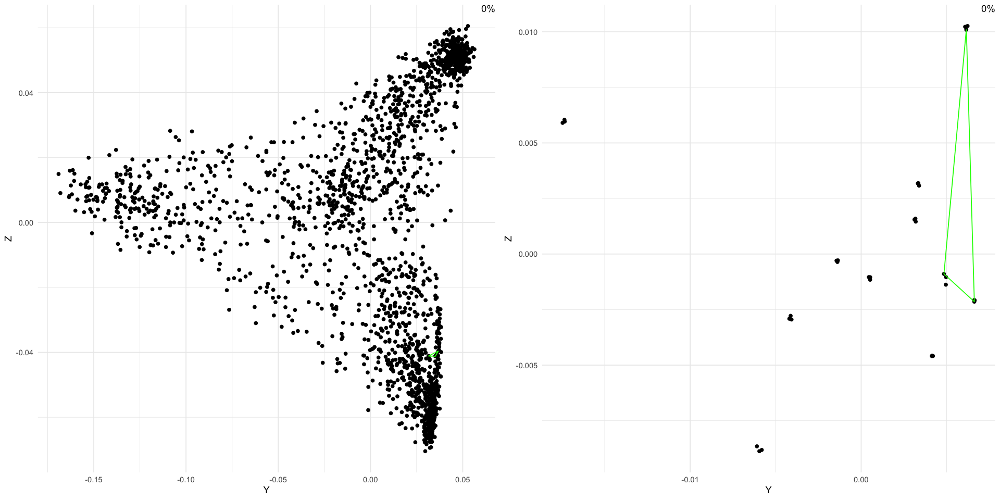

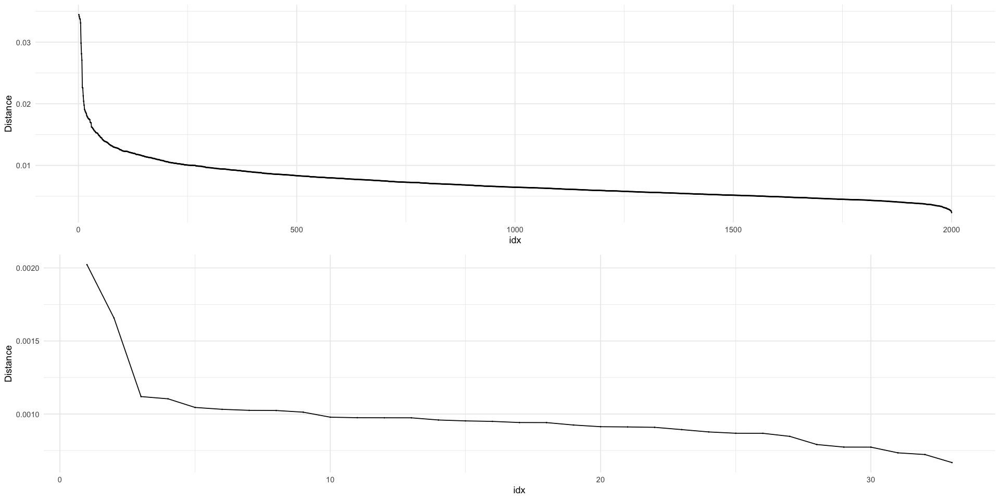

In [45]:
trainAndVisualizeLinseed2(global_iterations = 2000, top_genes = 2000, init_centered = FALSE)

[1] "Scale dataset"



Scaling dataset [===>------------------------]  15% eta:  1s

Scaling dataset [=====>----------------------]  20% eta:  1s

Scaling dataset [======>---------------------]  25% eta:  1s

Scaling dataset [=======>--------------------]  30% eta:  1s

Scaling dataset [=========>------------------]  35% eta:  1s

Scaling dataset [==========>-----------------]  40% eta:  1s

Scaling dataset [============>---------------]  45% eta:  1s

Scaling dataset [=============>--------------]  50% eta:  1s

Scaling dataset [==============>-------------]  55% eta:  1s

Scaling dataset [================>-----------]  60% eta:  1s

Scaling dataset [=================>----------]  65% eta:  1s

Scaling dataset [===================>--------]  70% eta:  1s

Scaling dataset [====================>-------]  75% eta:  1s

Scaling dataset [=====================>------]  80% eta:  0s

Scaling dataset [=======================>----]  85% eta:  0s

Scaling dataset [========================>---]  90% eta:  0s

Scaling

[1] "Get SVD projections"
[1] "Find initial points"
[1] "Run optimization"


Warning message in melt(toPlot, id.vars = "iteration", measure.vars = variables):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(toPlot). In the next version, this warning will become an error.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


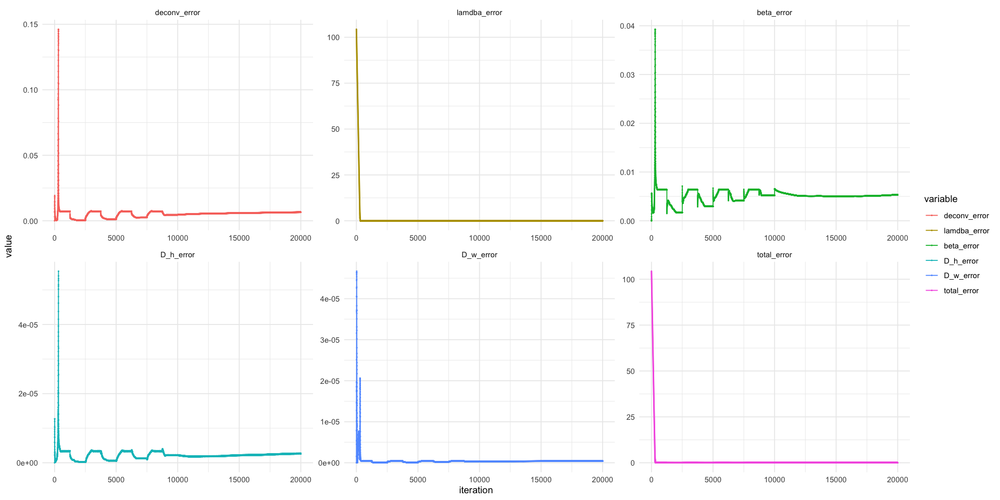

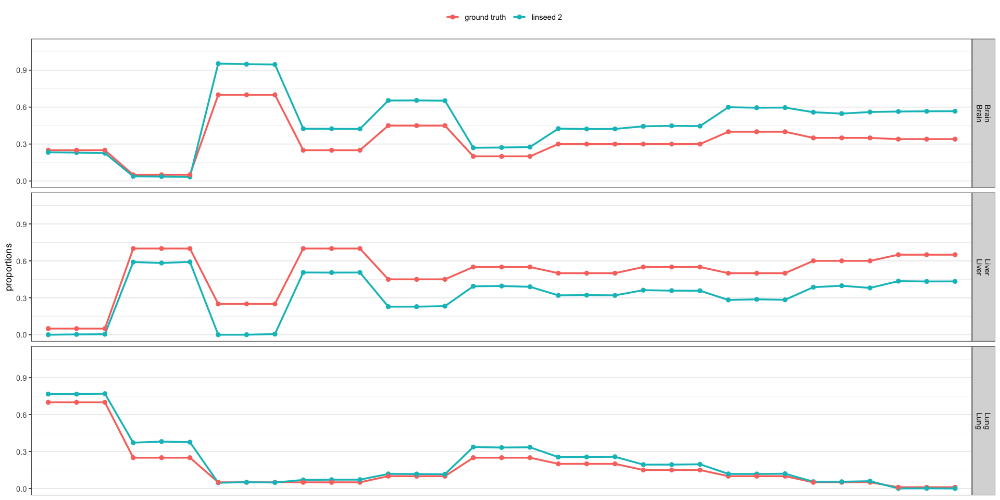

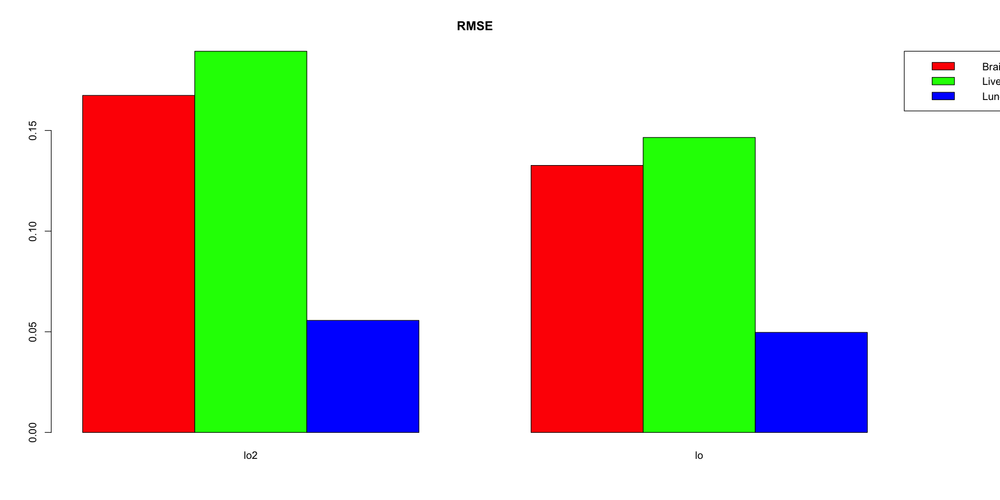

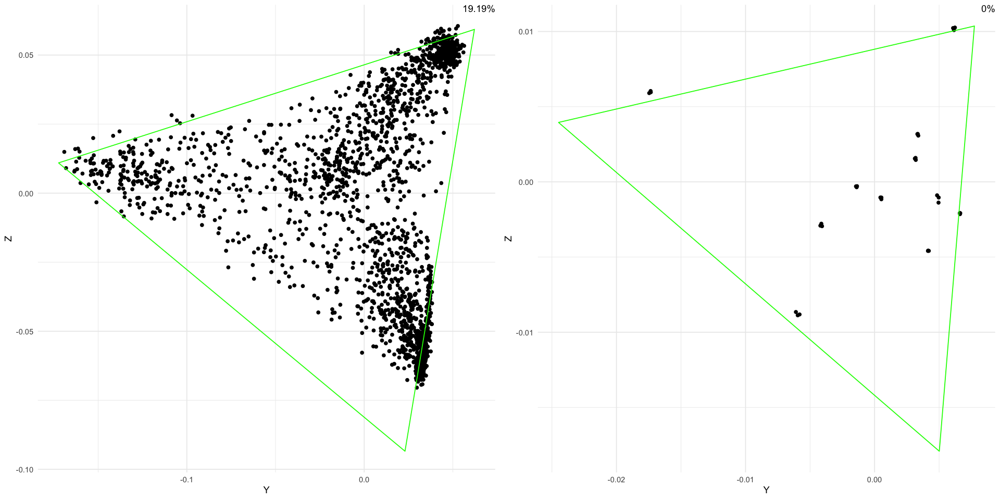

In [206]:
trainAndVisualizeLinseed2(global_iterations = 10000, top_genes = 2000)

[1] "Scale dataset"



Scaling dataset [===>------------------------]  15% eta:  1s

Scaling dataset [=====>----------------------]  20% eta:  1s

Scaling dataset [======>---------------------]  25% eta:  1s

Scaling dataset [=======>--------------------]  30% eta:  1s

Scaling dataset [=========>------------------]  35% eta:  1s

Scaling dataset [==========>-----------------]  40% eta:  2s

Scaling dataset [============>---------------]  45% eta:  2s

Scaling dataset [=============>--------------]  50% eta:  1s

Scaling dataset [==============>-------------]  55% eta:  1s

Scaling dataset [================>-----------]  60% eta:  1s

Scaling dataset [=================>----------]  65% eta:  1s

Scaling dataset [===================>--------]  70% eta:  1s

Scaling dataset [====================>-------]  75% eta:  1s

Scaling dataset [=====================>------]  80% eta:  1s

Scaling dataset [=======================>----]  85% eta:  0s

Scaling dataset [========================>---]  90% eta:  0s

Scaling

[1] "Get SVD projections"
[1] "Find initial points"
[1] "Run optimization"


Warning message in melt(toPlot, id.vars = "iteration", measure.vars = variables):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(toPlot). In the next version, this warning will become an error.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


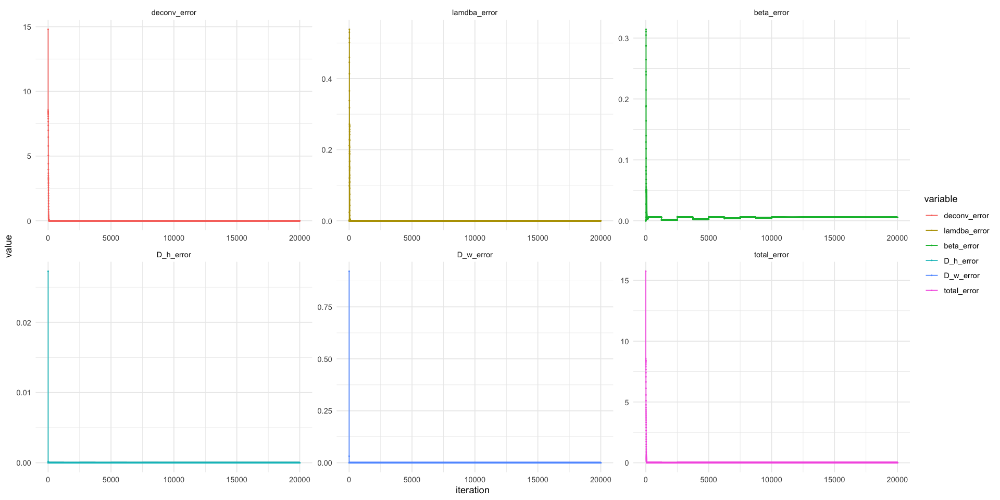

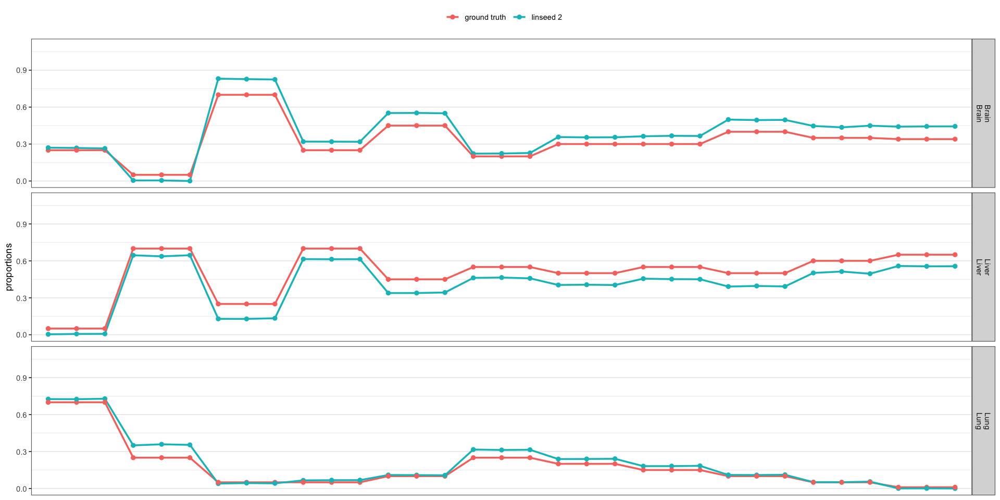

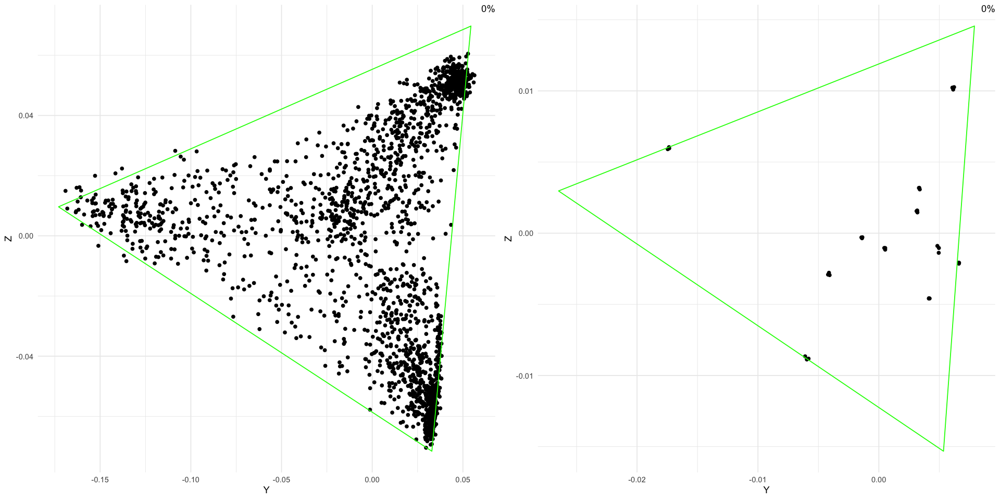

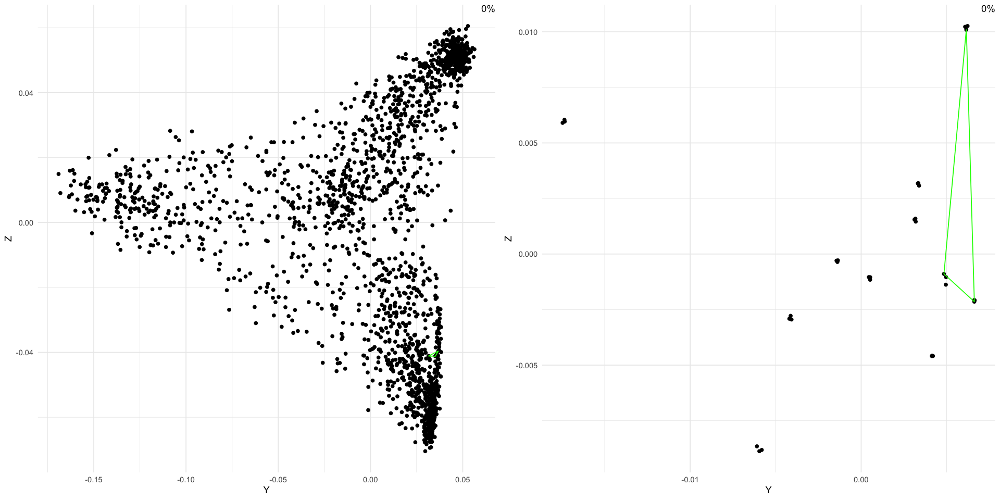

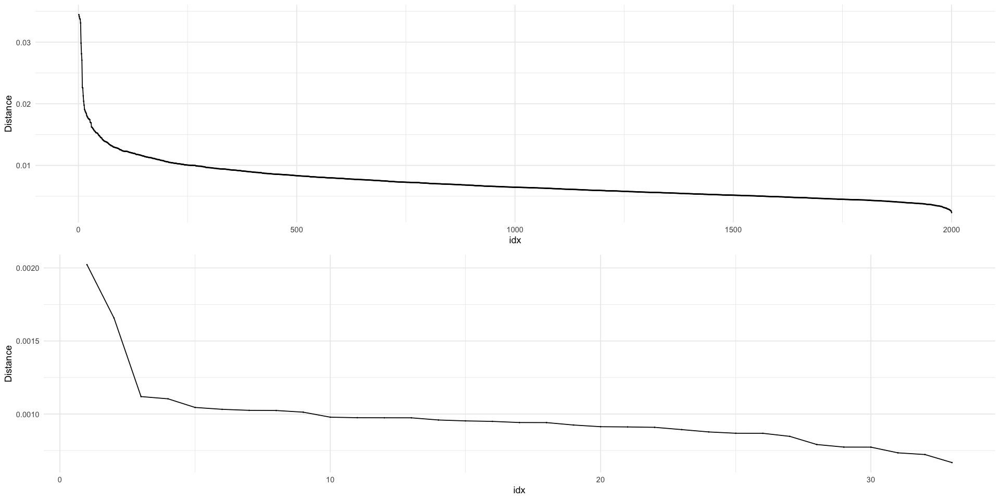

In [46]:
trainAndVisualizeLinseed2(global_iterations = 10000, top_genes = 2000, init_centered = FALSE)

[1] "Scale dataset"



Scaling dataset [==>-------------------------]  10% eta:  8s

Scaling dataset [===>------------------------]  15% eta:  9s

Scaling dataset [=====>----------------------]  20% eta:  8s

Scaling dataset [======>---------------------]  25% eta:  8s

Scaling dataset [=======>--------------------]  30% eta:  7s

Scaling dataset [=========>------------------]  35% eta:  7s

Scaling dataset [==========>-----------------]  40% eta:  6s

Scaling dataset [============>---------------]  45% eta:  6s

Scaling dataset [=============>--------------]  50% eta:  5s

Scaling dataset [==============>-------------]  55% eta:  5s

Scaling dataset [================>-----------]  60% eta:  4s

Scaling dataset [=================>----------]  65% eta:  4s

Scaling dataset [===================>--------]  70% eta:  3s

Scaling dataset [====================>-------]  75% eta:  3s

Scaling dataset [=====================>------]  80% eta:  2s

Scaling dataset [=======================>----]  85% eta:  2s

Scaling

[1] "Get SVD projections"
[1] "Find initial points"
[1] "Run optimization"


Warning message in melt(toPlot, id.vars = "iteration", measure.vars = variables):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(toPlot). In the next version, this warning will become an error.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


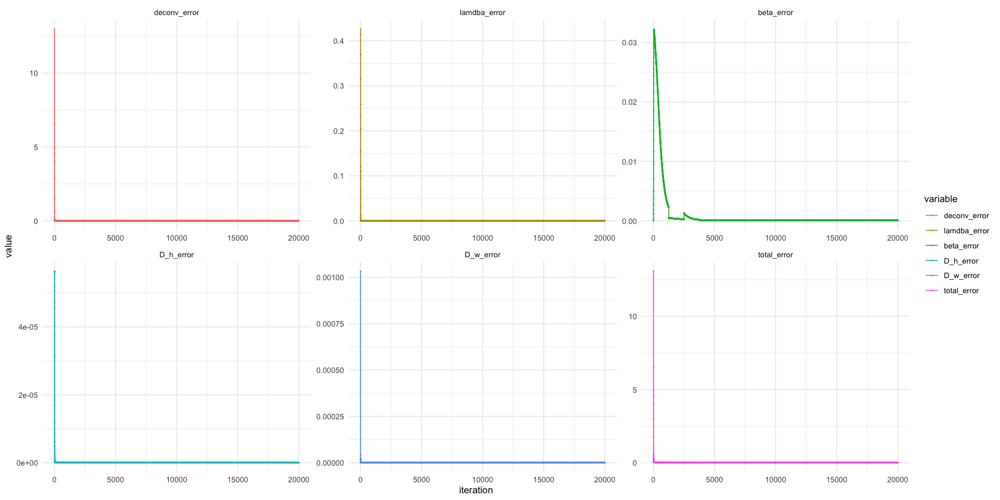

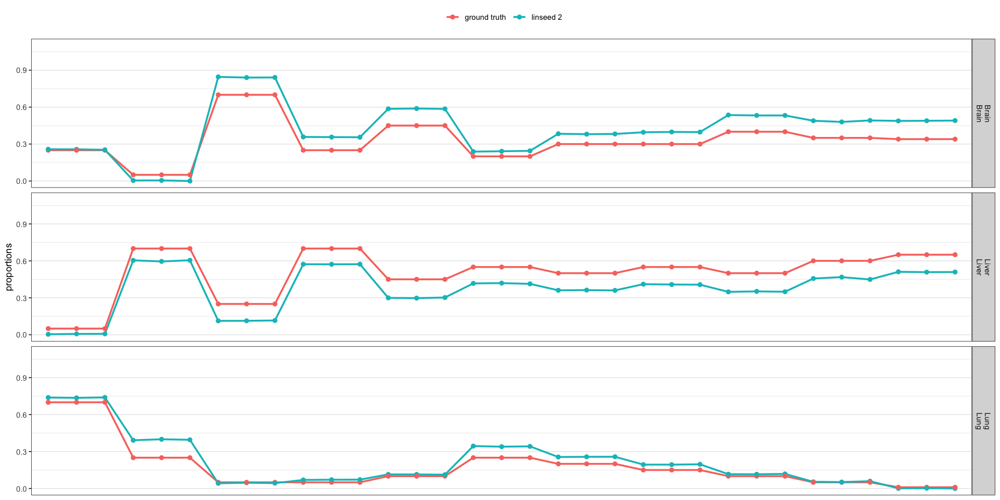

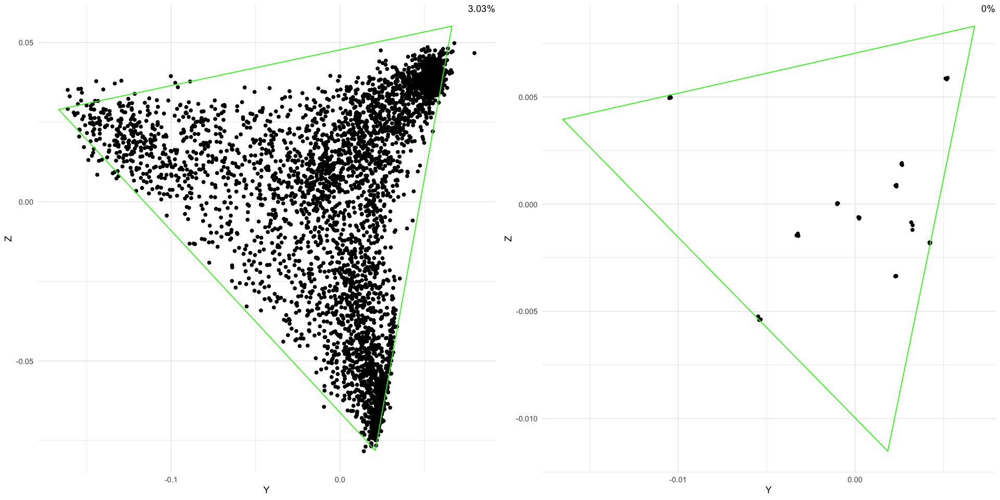

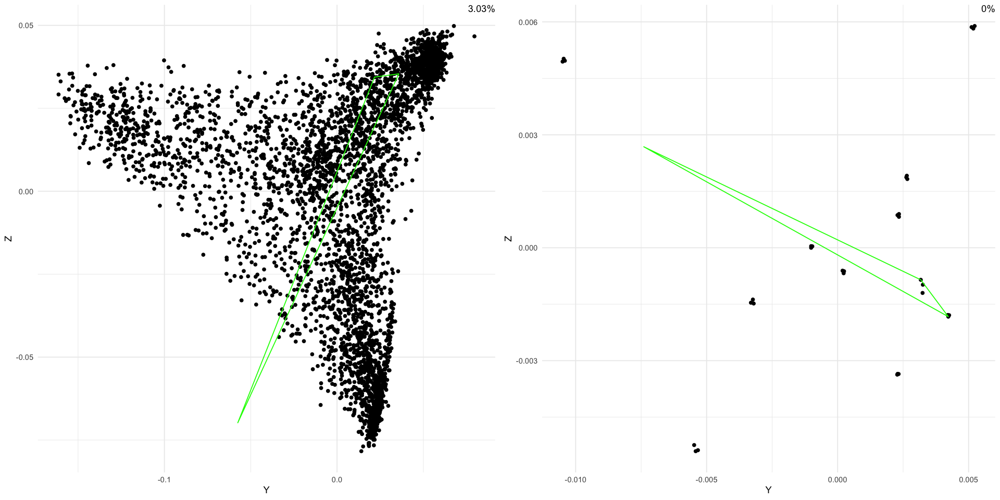

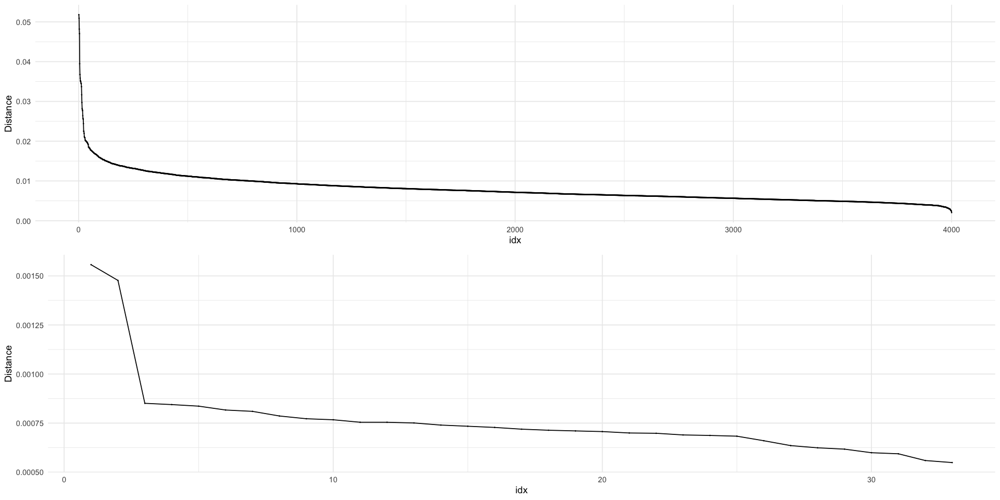

In [47]:
trainAndVisualizeLinseed2(global_iterations = 10000, top_genes = 4000, coef_hinge_W = 0.1)

[1] "Scale dataset"



Scaling dataset [==>-------------------------]  10% eta:  4s

Scaling dataset [===>------------------------]  15% eta:  5s

Scaling dataset [=====>----------------------]  20% eta:  5s

Scaling dataset [======>---------------------]  25% eta:  6s

Scaling dataset [=======>--------------------]  30% eta:  6s

Scaling dataset [=========>------------------]  35% eta:  6s

Scaling dataset [==========>-----------------]  40% eta:  5s

Scaling dataset [============>---------------]  45% eta:  5s

Scaling dataset [=============>--------------]  50% eta:  4s

Scaling dataset [==============>-------------]  55% eta:  4s

Scaling dataset [================>-----------]  60% eta:  4s

Scaling dataset [=================>----------]  65% eta:  3s

Scaling dataset [===================>--------]  70% eta:  3s

Scaling dataset [====================>-------]  75% eta:  2s

Scaling dataset [=====================>------]  80% eta:  2s

Scaling dataset [=======================>----]  85% eta:  1s

Scaling

[1] "Get SVD projections"
[1] "Find initial points"
[1] "Run optimization"


Warning message in melt(toPlot, id.vars = "iteration", measure.vars = variables):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(toPlot). In the next version, this warning will become an error.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


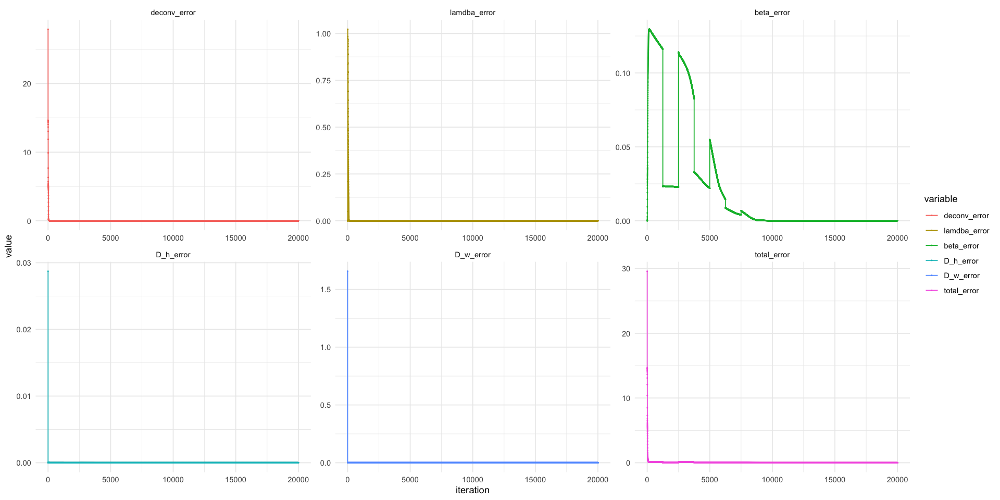

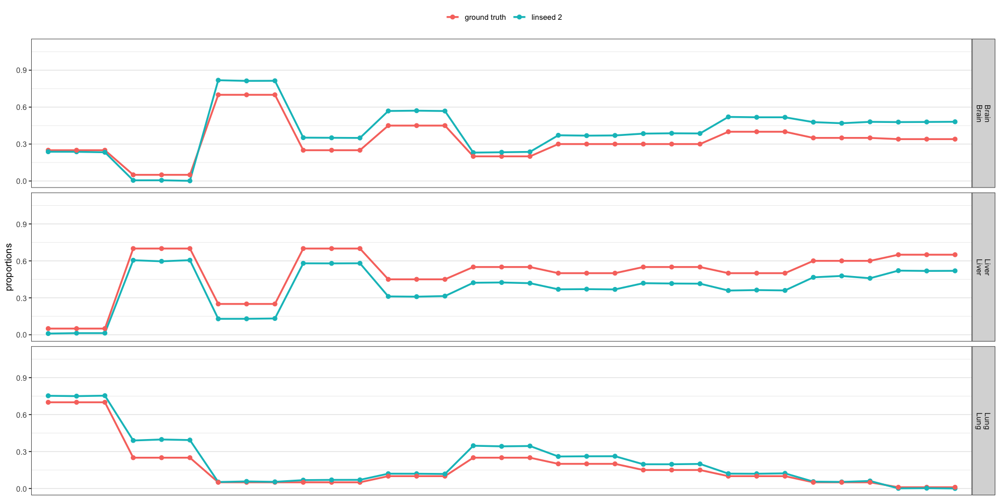

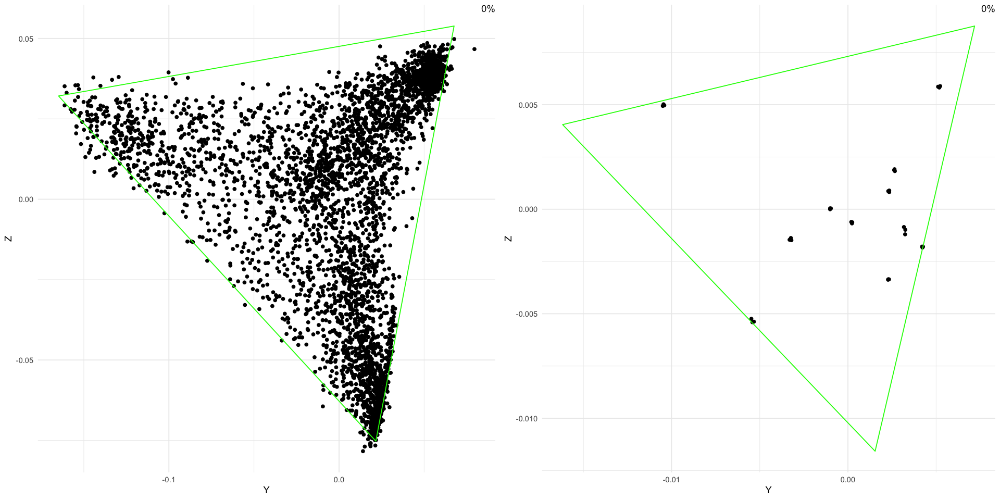

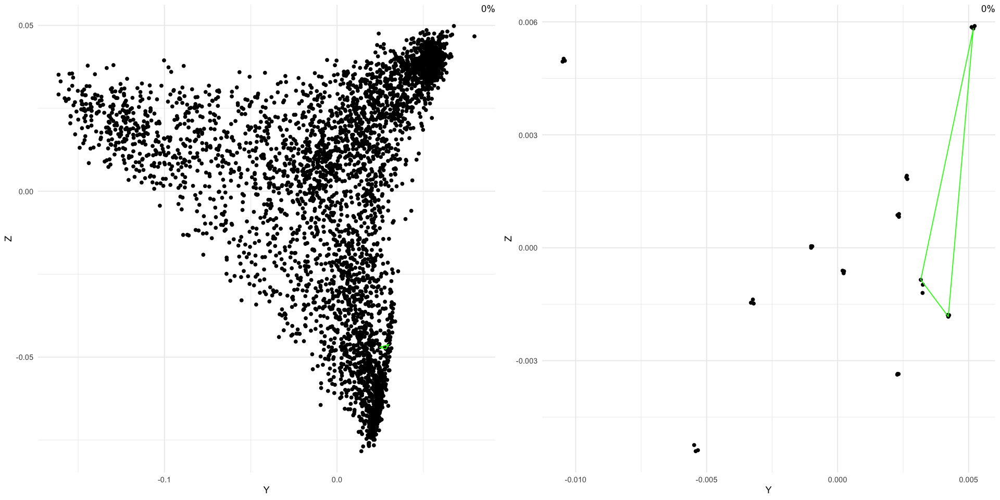

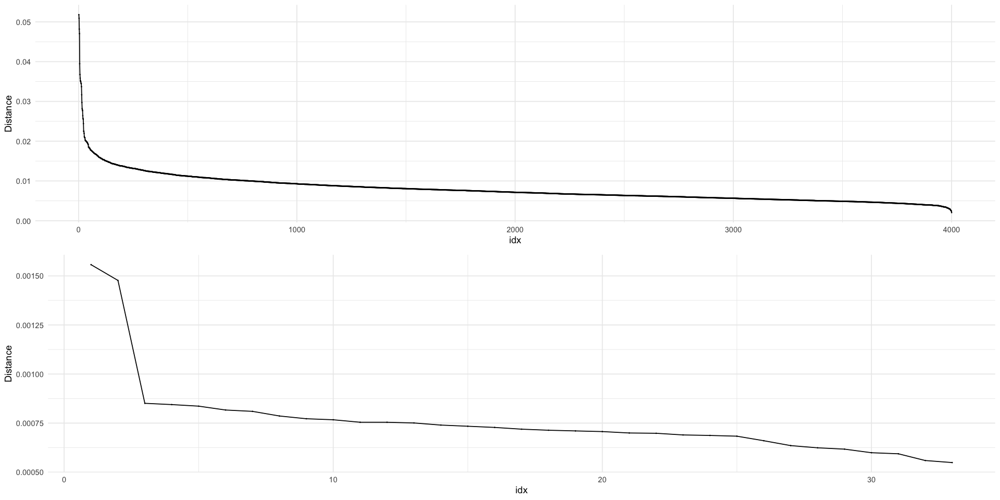

In [48]:
trainAndVisualizeLinseed2(global_iterations = 10000, top_genes = 4000, coef_hinge_W = 0.1, init_centered = FALSE)

[1] "Scale dataset"



Scaling dataset [==>-------------------------]  10% eta:  4s

Scaling dataset [===>------------------------]  15% eta:  6s

Scaling dataset [=====>----------------------]  20% eta:  6s

Scaling dataset [======>---------------------]  25% eta:  6s

Scaling dataset [=======>--------------------]  30% eta:  6s

Scaling dataset [=========>------------------]  35% eta:  6s

Scaling dataset [==========>-----------------]  40% eta:  5s

Scaling dataset [============>---------------]  45% eta:  5s

Scaling dataset [=============>--------------]  50% eta:  4s

Scaling dataset [==============>-------------]  55% eta:  4s

Scaling dataset [================>-----------]  60% eta:  4s

Scaling dataset [=================>----------]  65% eta:  3s

Scaling dataset [===================>--------]  70% eta:  3s

Scaling dataset [====================>-------]  75% eta:  2s

Scaling dataset [=====================>------]  80% eta:  2s

Scaling dataset [=======================>----]  85% eta:  1s

Scaling

[1] "Get SVD projections"
[1] "Find initial points"
[1] "Run optimization"


Warning message in melt(toPlot, id.vars = "iteration", measure.vars = variables):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(toPlot). In the next version, this warning will become an error.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


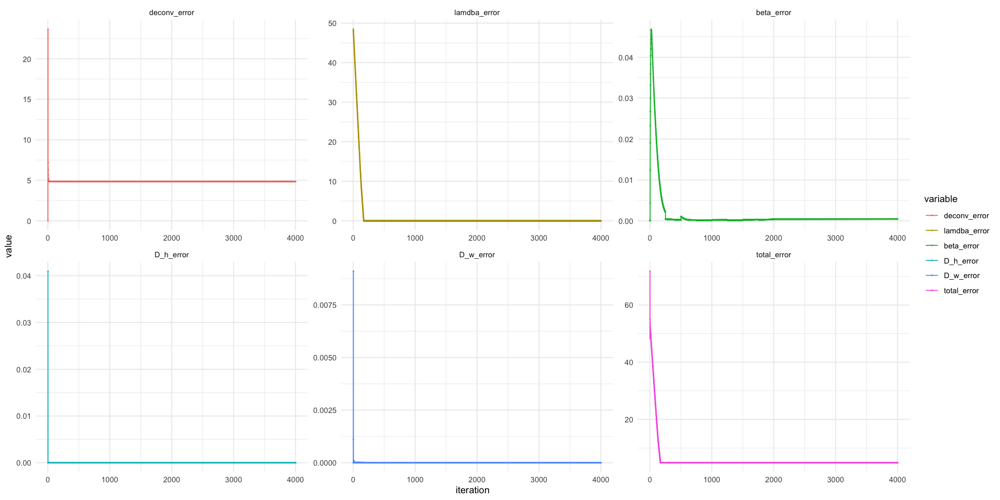

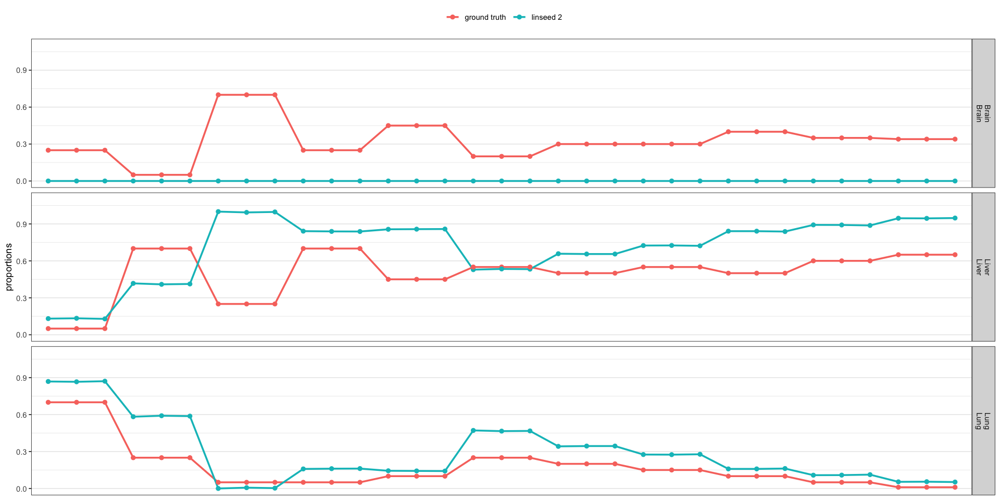

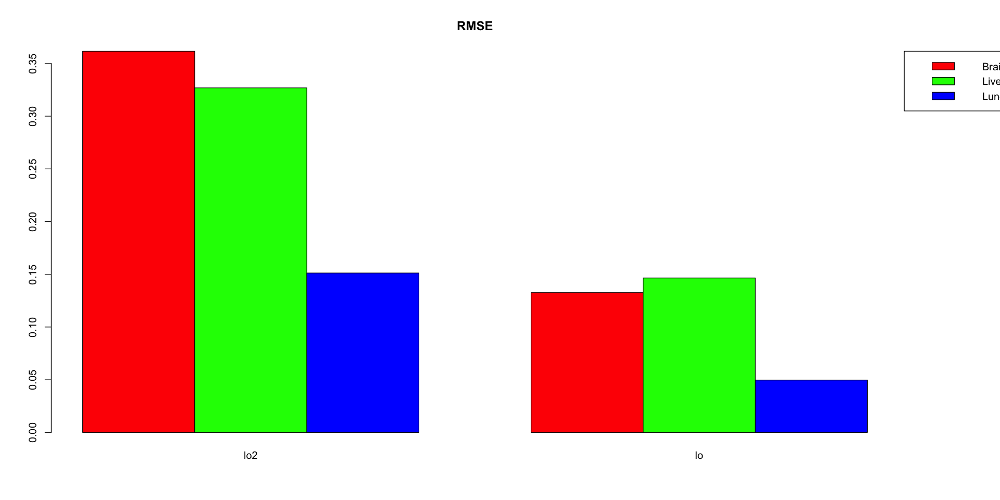

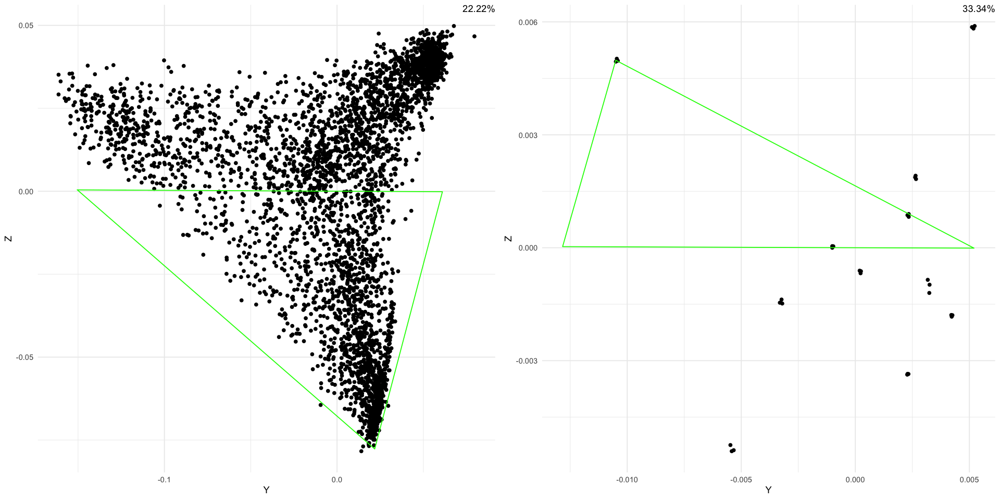

In [209]:
trainAndVisualizeLinseed2(global_iterations = 2000, top_genes = 4000, coef_hinge_W = 1)

[1] "Scale dataset"



Scaling dataset [==>-------------------------]  10% eta:  4s

Scaling dataset [===>------------------------]  15% eta:  5s

Scaling dataset [=====>----------------------]  20% eta:  5s

Scaling dataset [======>---------------------]  25% eta:  5s

Scaling dataset [=======>--------------------]  30% eta:  5s

Scaling dataset [=========>------------------]  35% eta:  5s

Scaling dataset [==========>-----------------]  40% eta:  5s

Scaling dataset [============>---------------]  45% eta:  4s

Scaling dataset [=============>--------------]  50% eta:  4s

Scaling dataset [==============>-------------]  55% eta:  4s

Scaling dataset [================>-----------]  60% eta:  3s

Scaling dataset [=================>----------]  65% eta:  3s

Scaling dataset [===================>--------]  70% eta:  2s

Scaling dataset [====================>-------]  75% eta:  2s

Scaling dataset [=====================>------]  80% eta:  2s

Scaling dataset [=======================>----]  85% eta:  1s

Scaling

[1] "Get SVD projections"
[1] "Find initial points"
[1] "Run optimization"


Warning message in melt(toPlot, id.vars = "iteration", measure.vars = variables):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(toPlot). In the next version, this warning will become an error.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


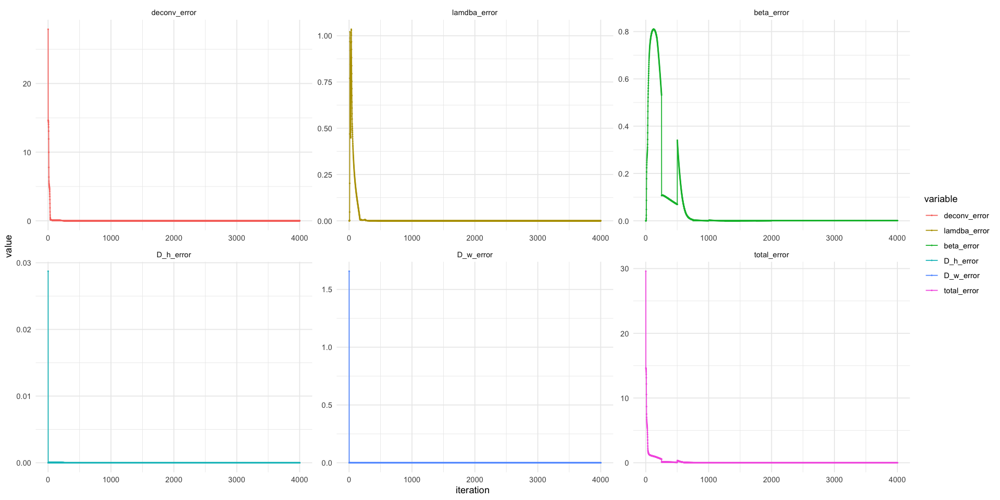

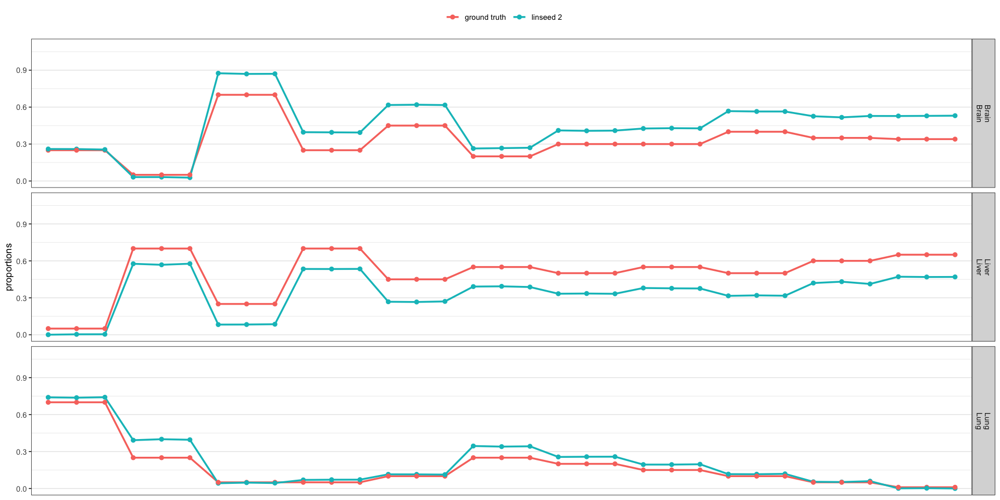

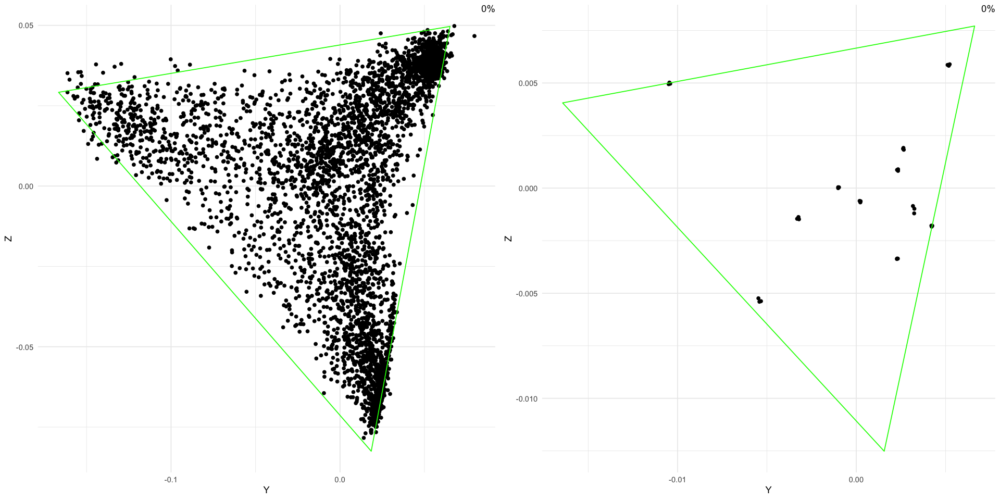

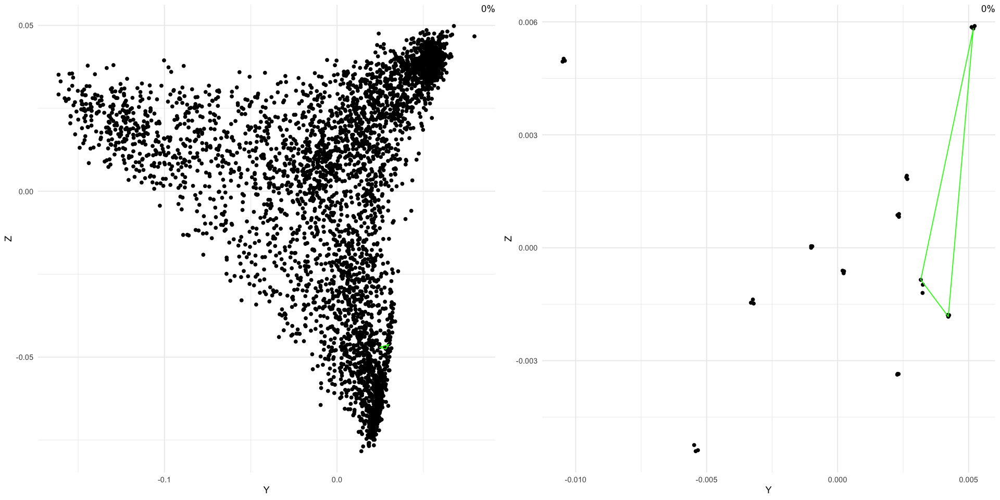

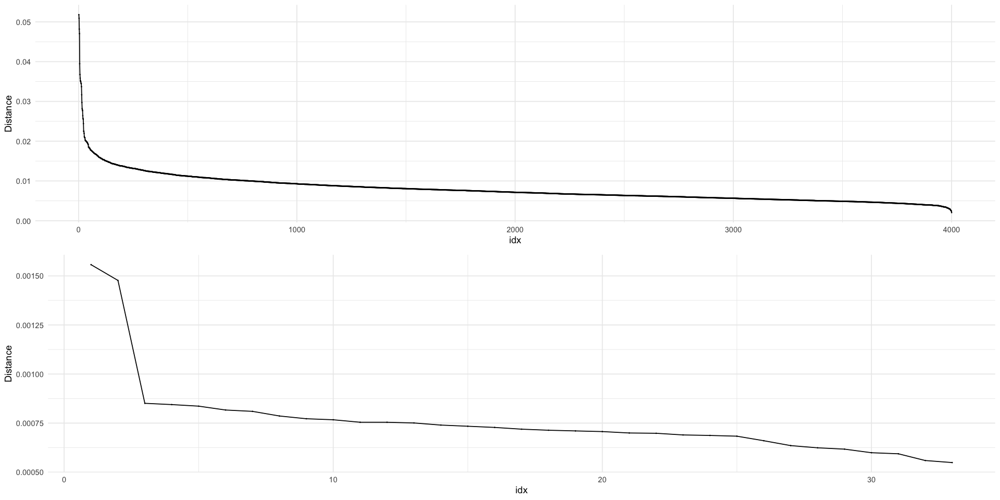

In [49]:
trainAndVisualizeLinseed2(global_iterations = 2000, top_genes = 4000, coef_hinge_W = 1, init_centered = FALSE)

[1] "Scale dataset"



Scaling dataset [==>-------------------------]  10% eta:  4s

Scaling dataset [===>------------------------]  15% eta:  5s

Scaling dataset [=====>----------------------]  20% eta:  5s

Scaling dataset [======>---------------------]  25% eta:  5s

Scaling dataset [=======>--------------------]  30% eta:  5s

Scaling dataset [=========>------------------]  35% eta:  5s

Scaling dataset [==========>-----------------]  40% eta:  5s

Scaling dataset [============>---------------]  45% eta:  4s

Scaling dataset [=============>--------------]  50% eta:  4s

Scaling dataset [==============>-------------]  55% eta:  4s

Scaling dataset [================>-----------]  60% eta:  3s

Scaling dataset [=================>----------]  65% eta:  3s

Scaling dataset [===================>--------]  70% eta:  3s

Scaling dataset [====================>-------]  75% eta:  2s

Scaling dataset [=====================>------]  80% eta:  2s

Scaling dataset [=======================>----]  85% eta:  1s

Scaling

[1] "Get SVD projections"
[1] "Find initial points"
[1] "Run optimization"


Warning message in melt(toPlot, id.vars = "iteration", measure.vars = variables):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(toPlot). In the next version, this warning will become an error.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


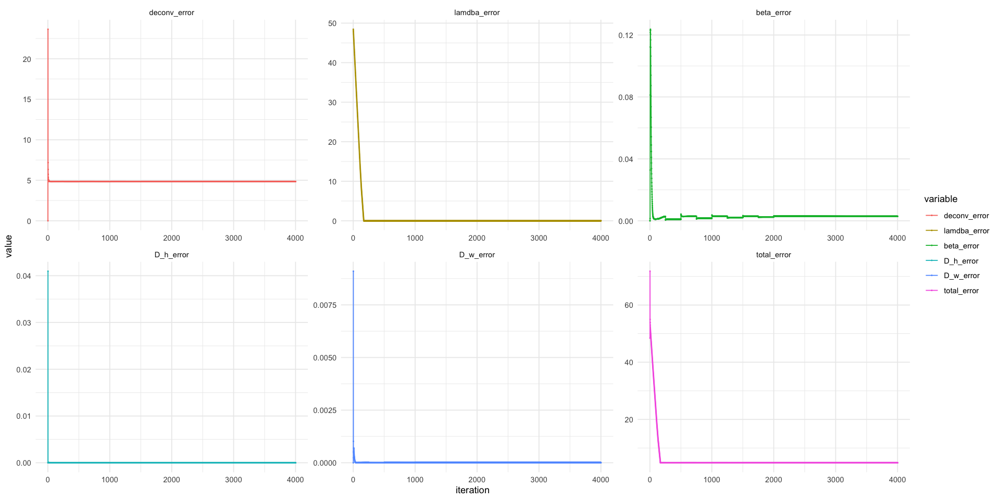

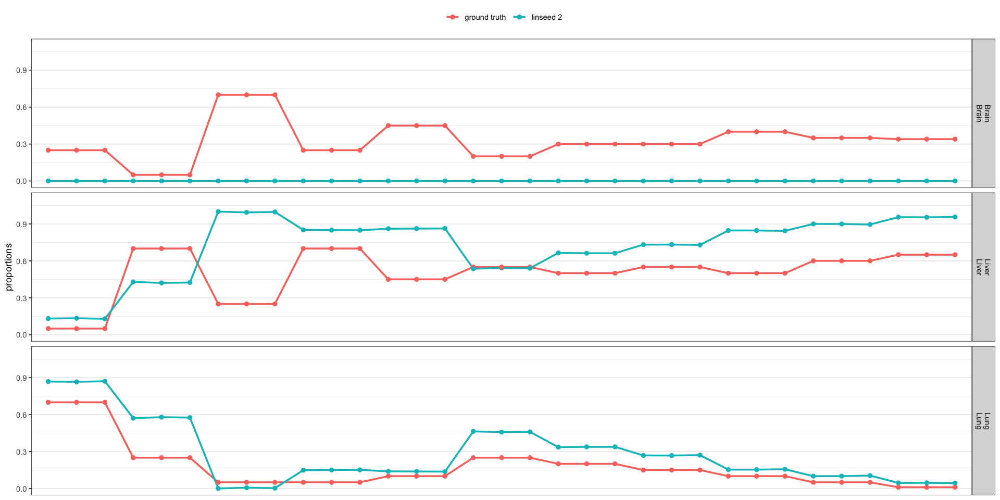

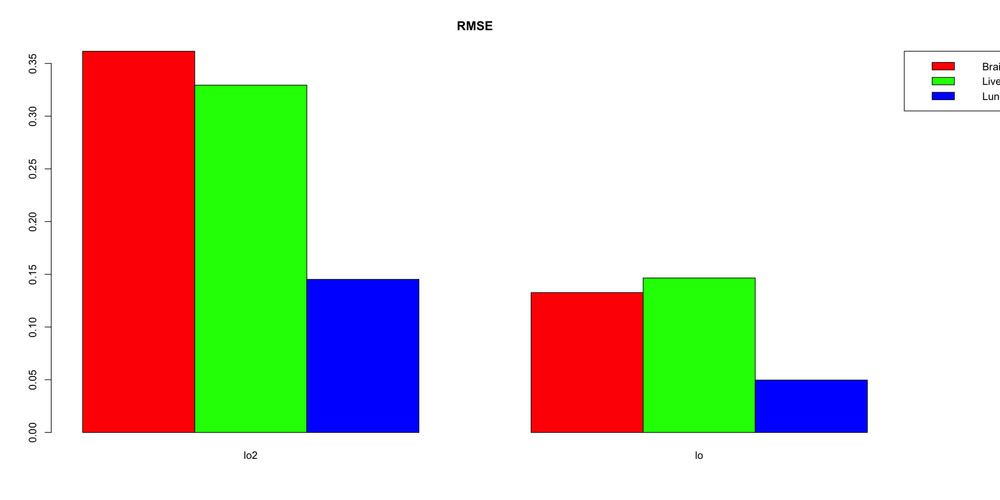

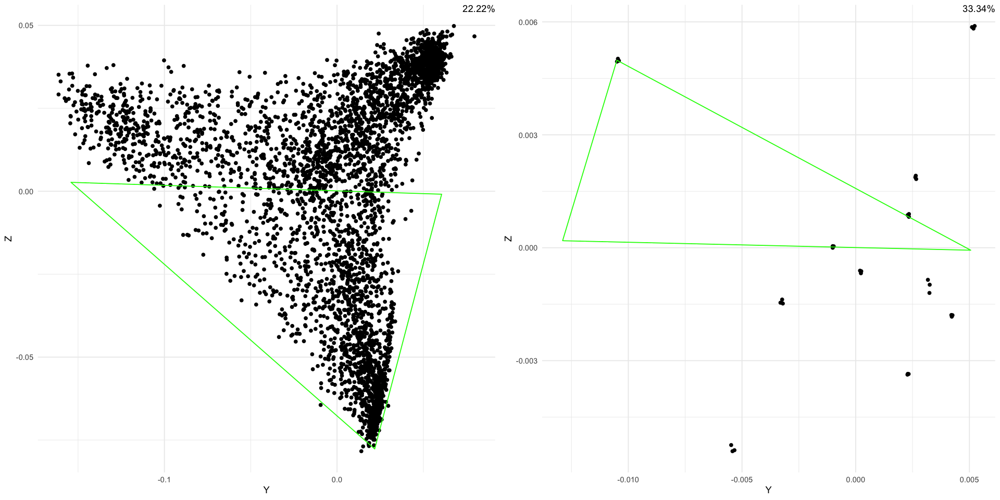

In [210]:
trainAndVisualizeLinseed2(global_iterations = 2000, top_genes = 4000)

[1] "Scale dataset"



Scaling dataset [==>-------------------------]  10% eta:  4s

Scaling dataset [===>------------------------]  15% eta:  5s

Scaling dataset [=====>----------------------]  20% eta:  5s

Scaling dataset [======>---------------------]  25% eta:  6s

Scaling dataset [=======>--------------------]  30% eta:  6s

Scaling dataset [=========>------------------]  35% eta:  6s

Scaling dataset [==========>-----------------]  40% eta:  5s

Scaling dataset [============>---------------]  45% eta:  5s

Scaling dataset [=============>--------------]  50% eta:  5s

Scaling dataset [==============>-------------]  55% eta:  4s

Scaling dataset [================>-----------]  60% eta:  4s

Scaling dataset [=================>----------]  65% eta:  3s

Scaling dataset [===================>--------]  70% eta:  3s

Scaling dataset [====================>-------]  75% eta:  2s

Scaling dataset [=====================>------]  80% eta:  2s

Scaling dataset [=======================>----]  85% eta:  1s

Scaling

[1] "Get SVD projections"
[1] "Find initial points"
[1] "Run optimization"


Warning message in melt(toPlot, id.vars = "iteration", measure.vars = variables):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(toPlot). In the next version, this warning will become an error.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


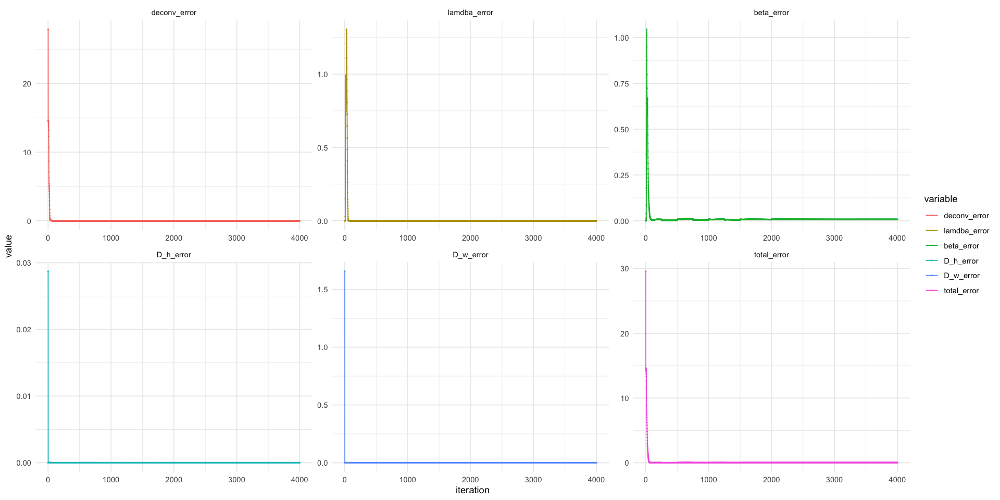

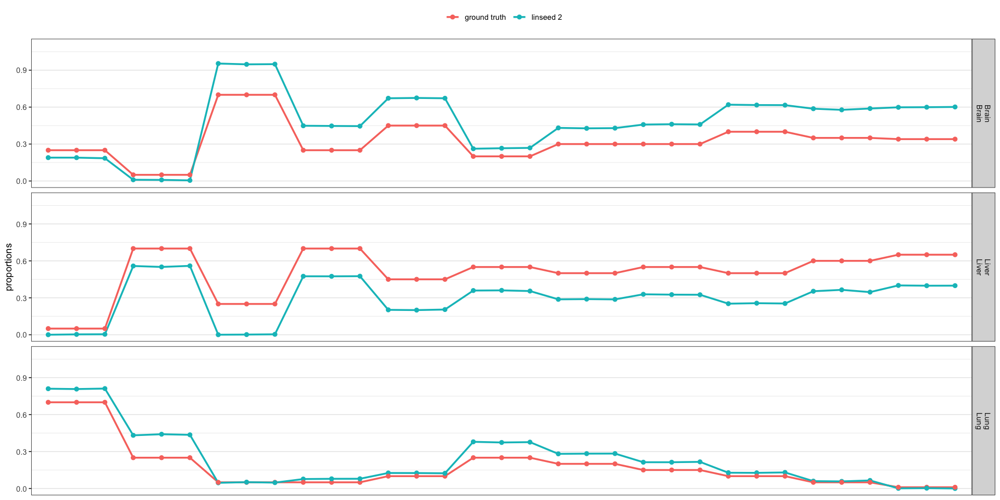

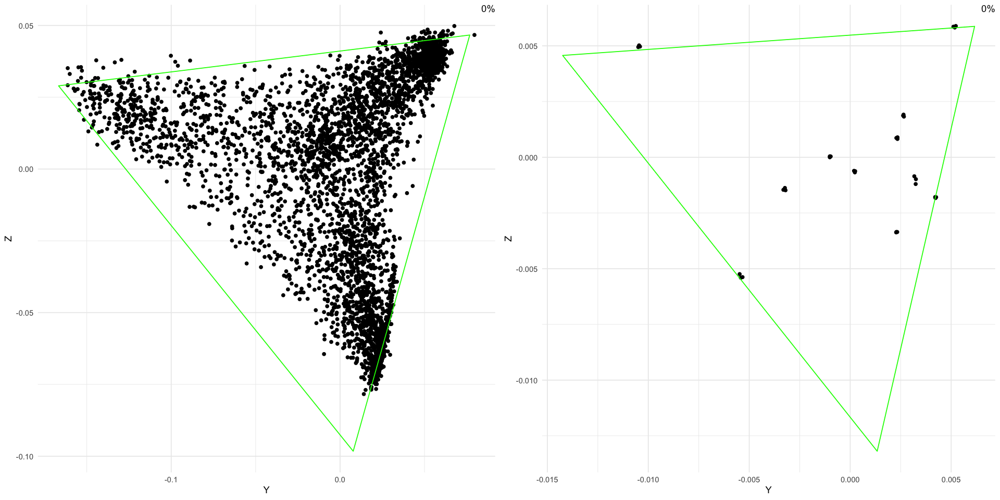

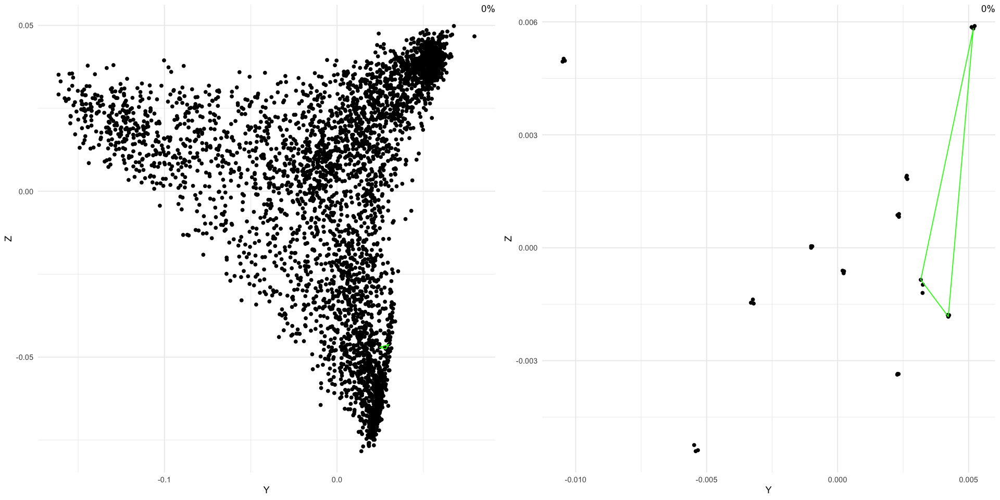

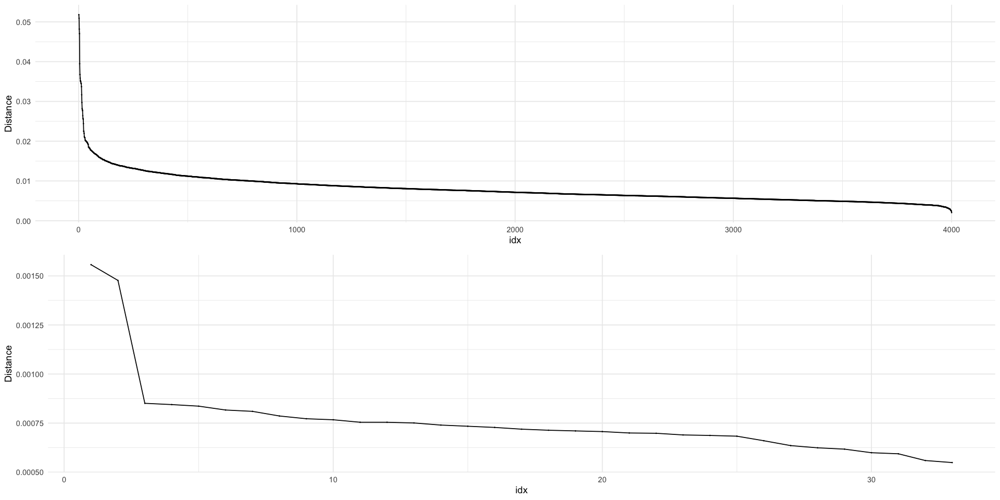

In [50]:
trainAndVisualizeLinseed2(global_iterations = 2000, top_genes = 4000, init_centered = FALSE)

[1] "Scale dataset"



Scaling dataset [==>-------------------------]  10% eta: 27s

Scaling dataset [===>------------------------]  15% eta: 33s

Scaling dataset [=====>----------------------]  20% eta: 35s

Scaling dataset [======>---------------------]  25% eta: 35s

Scaling dataset [=======>--------------------]  30% eta: 35s

Scaling dataset [=========>------------------]  35% eta: 33s

Scaling dataset [==========>-----------------]  40% eta: 32s

Scaling dataset [============>---------------]  45% eta: 30s

Scaling dataset [=============>--------------]  50% eta: 27s

Scaling dataset [==============>-------------]  55% eta: 25s

Scaling dataset [================>-----------]  60% eta: 22s

Scaling dataset [=================>----------]  65% eta: 20s

Scaling dataset [===================>--------]  70% eta: 17s

Scaling dataset [====================>-------]  75% eta: 14s

Scaling dataset [=====================>------]  80% eta: 11s

Scaling dataset [=======================>----]  85% eta:  9s

Scaling

[1] "Get SVD projections"
[1] "Find initial points"
[1] "Run optimization"


Warning message in melt(toPlot, id.vars = "iteration", measure.vars = variables):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(toPlot). In the next version, this warning will become an error.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


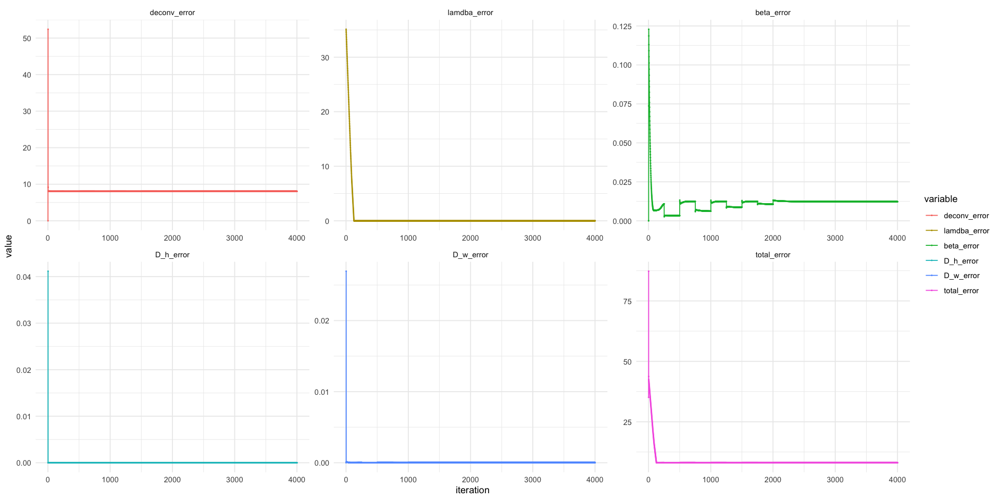

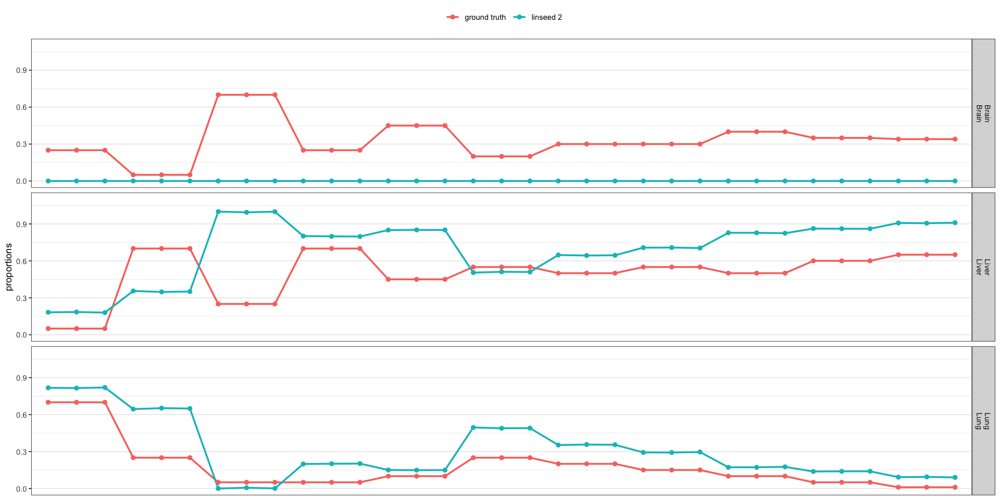

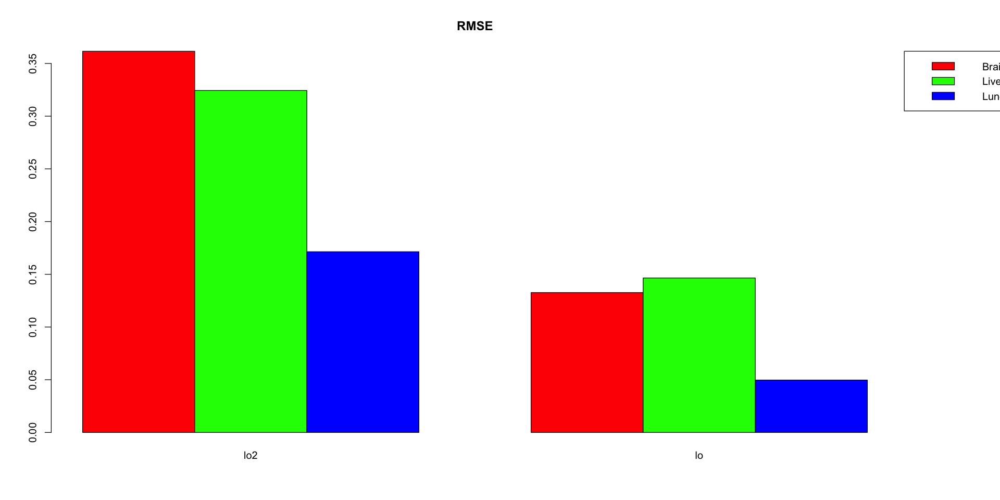

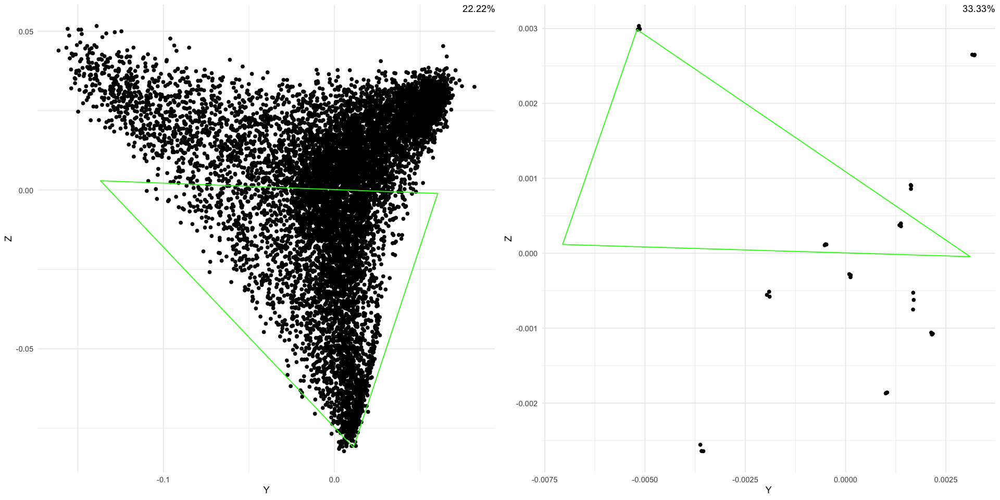

In [211]:
trainAndVisualizeLinseed2(global_iterations = 2000, top_genes = 10000)

[1] "Scale dataset"



Scaling dataset [==>-------------------------]  10% eta: 29s

Scaling dataset [===>------------------------]  15% eta: 37s

Scaling dataset [=====>----------------------]  20% eta: 38s

Scaling dataset [======>---------------------]  25% eta: 37s

Scaling dataset [=======>--------------------]  30% eta: 36s

Scaling dataset [=========>------------------]  35% eta: 34s

Scaling dataset [==========>-----------------]  40% eta: 32s

Scaling dataset [============>---------------]  45% eta: 30s

Scaling dataset [=============>--------------]  50% eta: 27s

Scaling dataset [==============>-------------]  55% eta: 25s

Scaling dataset [================>-----------]  60% eta: 22s

Scaling dataset [=================>----------]  65% eta: 20s

Scaling dataset [===================>--------]  70% eta: 17s

Scaling dataset [====================>-------]  75% eta: 14s

Scaling dataset [=====================>------]  80% eta: 11s

Scaling dataset [=======================>----]  85% eta:  9s

Scaling

[1] "Get SVD projections"
[1] "Find initial points"
[1] "Run optimization"


Warning message in melt(toPlot, id.vars = "iteration", measure.vars = variables):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(toPlot). In the next version, this warning will become an error.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


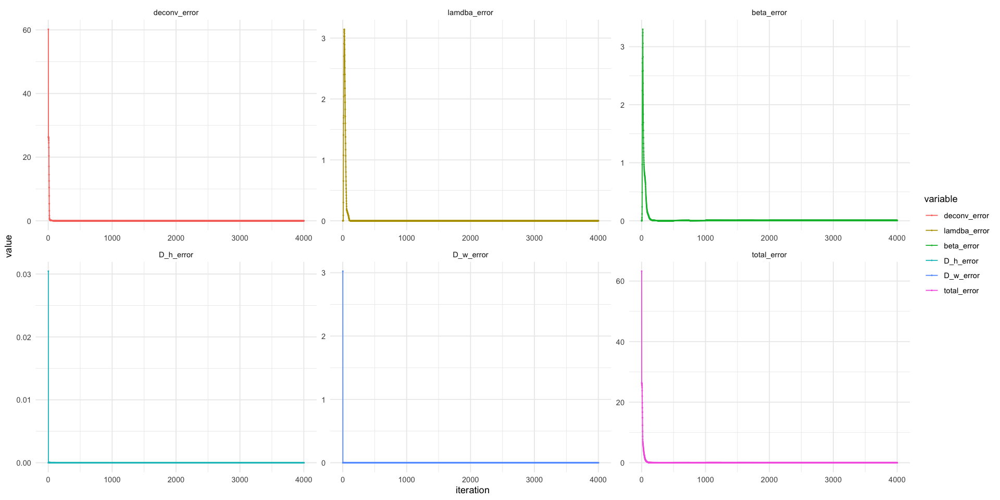

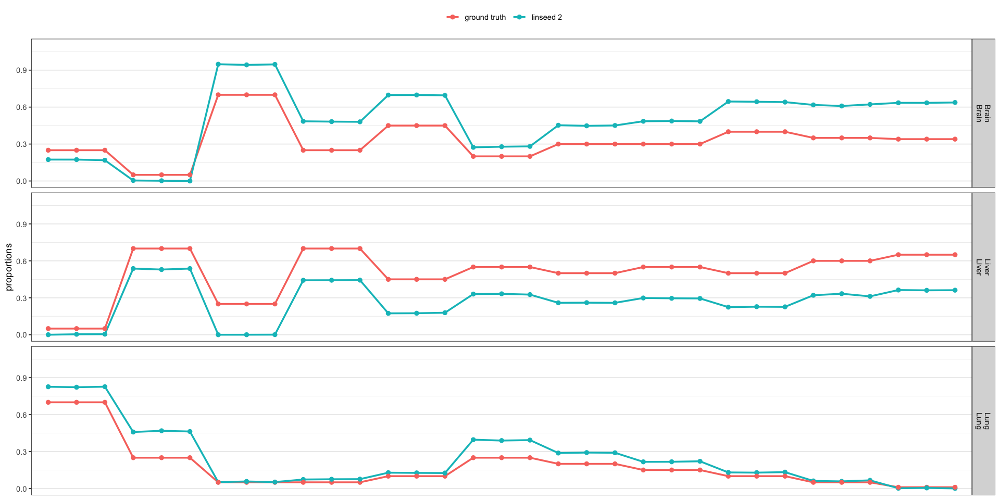

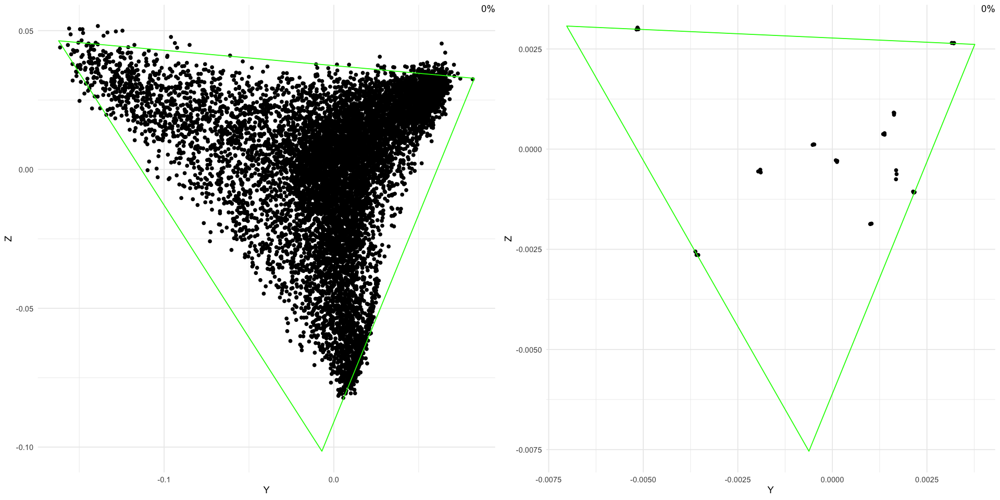

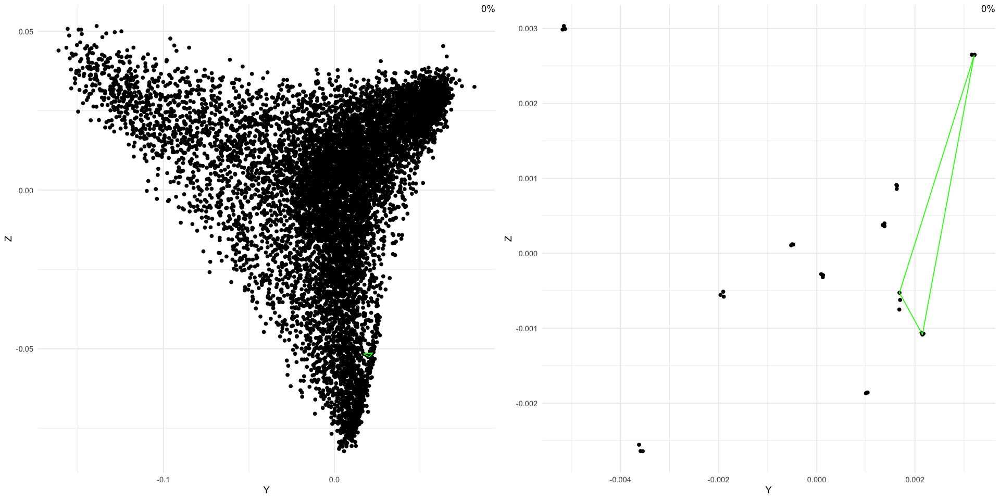

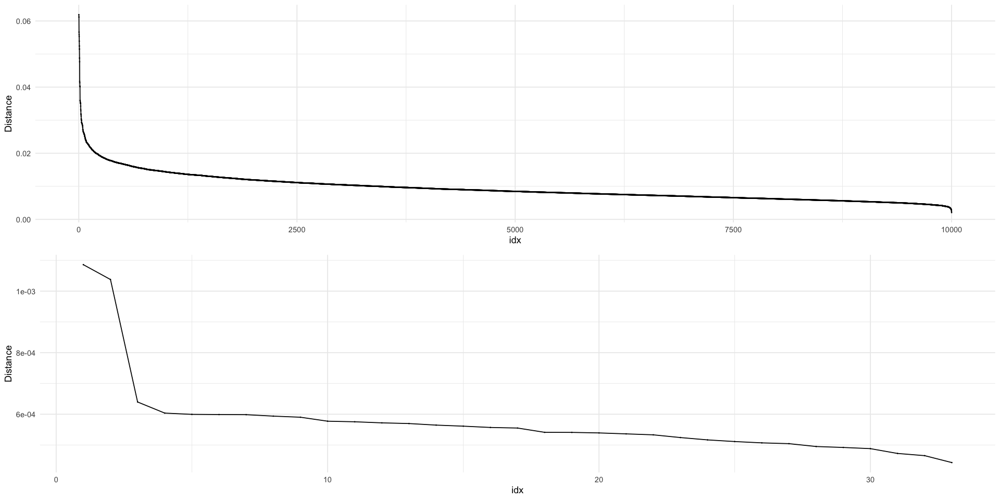

In [51]:
trainAndVisualizeLinseed2(global_iterations = 2000, top_genes = 10000, init_centered = FALSE)

[1] "Scale dataset"



Scaling dataset [==>-------------------------]  10% eta: 30s

Scaling dataset [===>------------------------]  15% eta: 36s

Scaling dataset [=====>----------------------]  20% eta: 38s

Scaling dataset [======>---------------------]  25% eta: 37s

Scaling dataset [=======>--------------------]  30% eta: 37s

Scaling dataset [=========>------------------]  35% eta: 35s

Scaling dataset [==========>-----------------]  40% eta: 32s

Scaling dataset [============>---------------]  45% eta: 30s

Scaling dataset [=============>--------------]  50% eta: 28s

Scaling dataset [==============>-------------]  55% eta: 25s

Scaling dataset [================>-----------]  60% eta: 22s

Scaling dataset [=================>----------]  65% eta: 20s

Scaling dataset [===================>--------]  70% eta: 17s

Scaling dataset [====================>-------]  75% eta: 14s

Scaling dataset [=====================>------]  80% eta: 11s

Scaling dataset [=======================>----]  85% eta:  9s

Scaling

[1] "Get SVD projections"
[1] "Find initial points"
[1] "Run optimization"


Warning message in melt(toPlot, id.vars = "iteration", measure.vars = variables):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(toPlot). In the next version, this warning will become an error.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


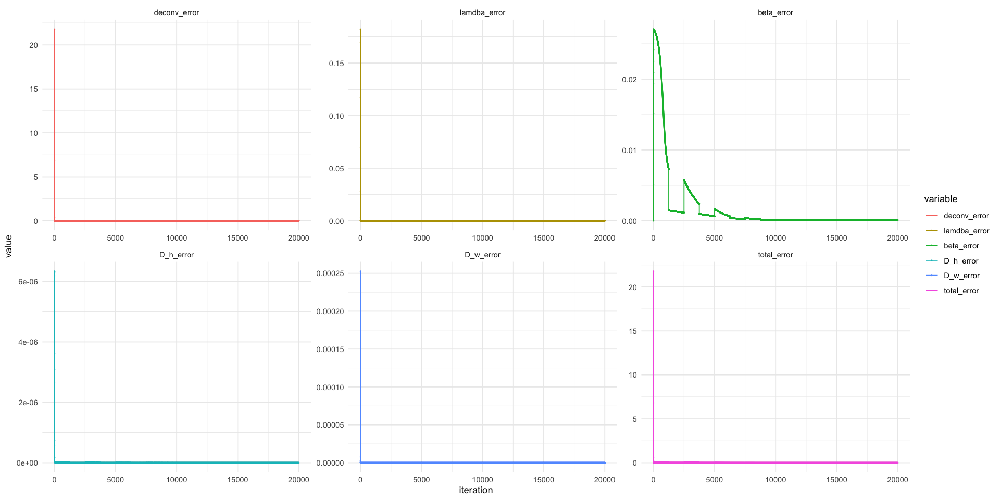

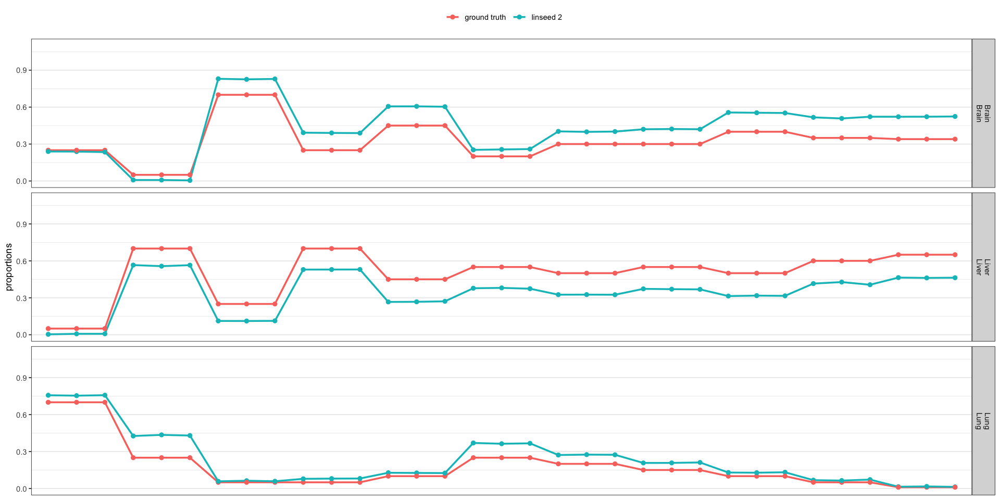

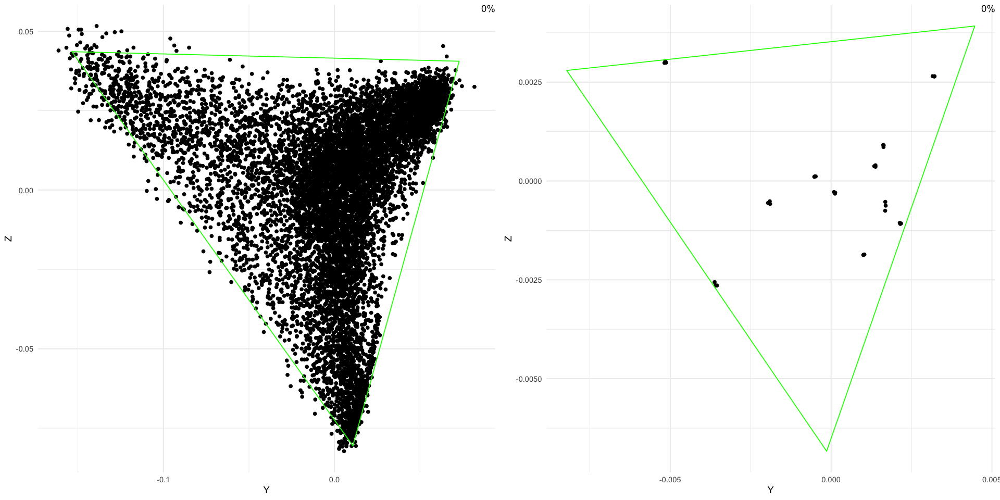

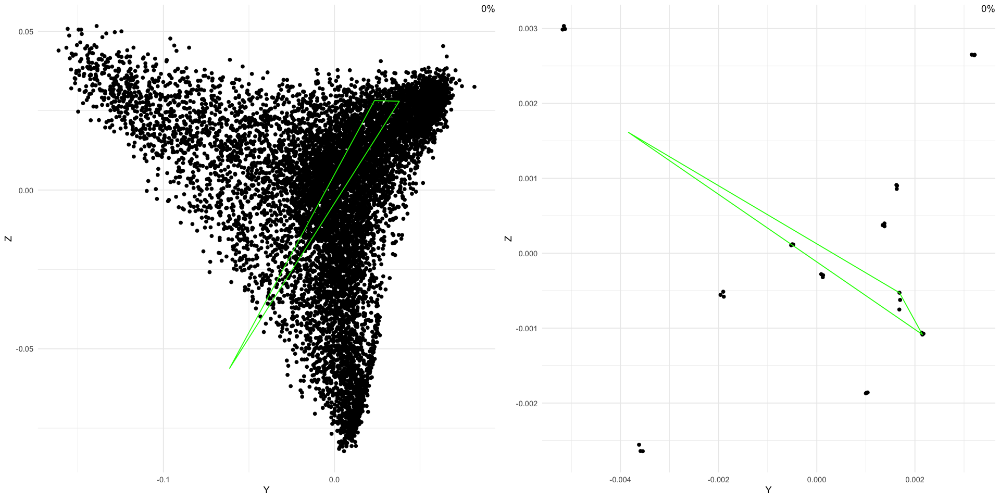

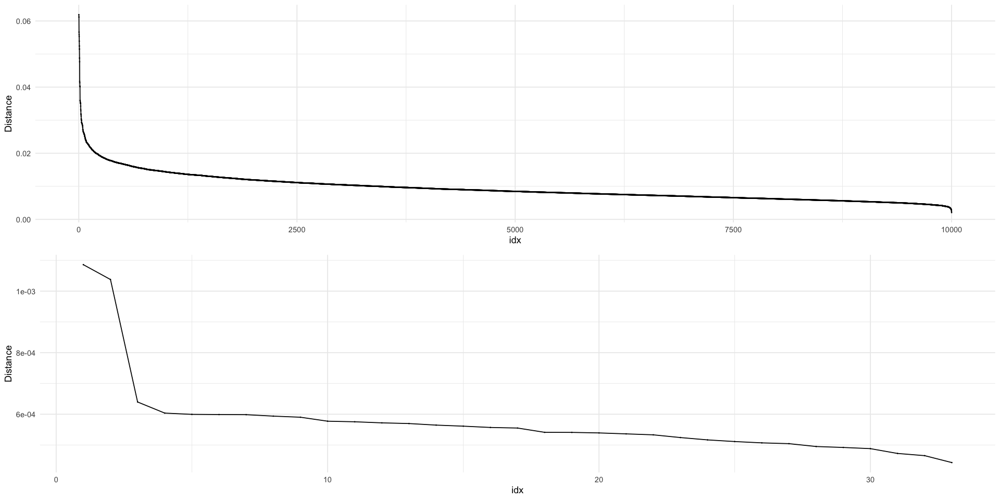

In [53]:
trainAndVisualizeLinseed2(global_iterations = 10000, top_genes = 10000, coef_hinge_W = 0.1)

[1] "Scale dataset"



Scaling dataset [==>-------------------------]  10% eta: 26s

Scaling dataset [===>------------------------]  15% eta: 34s

Scaling dataset [=====>----------------------]  20% eta: 37s

Scaling dataset [======>---------------------]  25% eta: 37s

Scaling dataset [=======>--------------------]  30% eta: 36s

Scaling dataset [=========>------------------]  35% eta: 34s

Scaling dataset [==========>-----------------]  40% eta: 32s

Scaling dataset [============>---------------]  45% eta: 30s

Scaling dataset [=============>--------------]  50% eta: 27s

Scaling dataset [==============>-------------]  55% eta: 25s

Scaling dataset [================>-----------]  60% eta: 22s

Scaling dataset [=================>----------]  65% eta: 20s

Scaling dataset [===================>--------]  70% eta: 17s

Scaling dataset [====================>-------]  75% eta: 14s

Scaling dataset [=====================>------]  80% eta: 11s

Scaling dataset [=======================>----]  85% eta:  9s

Scaling

[1] "Get SVD projections"
[1] "Find initial points"
[1] "Run optimization"


Warning message in melt(toPlot, id.vars = "iteration", measure.vars = variables):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(toPlot). In the next version, this warning will become an error.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


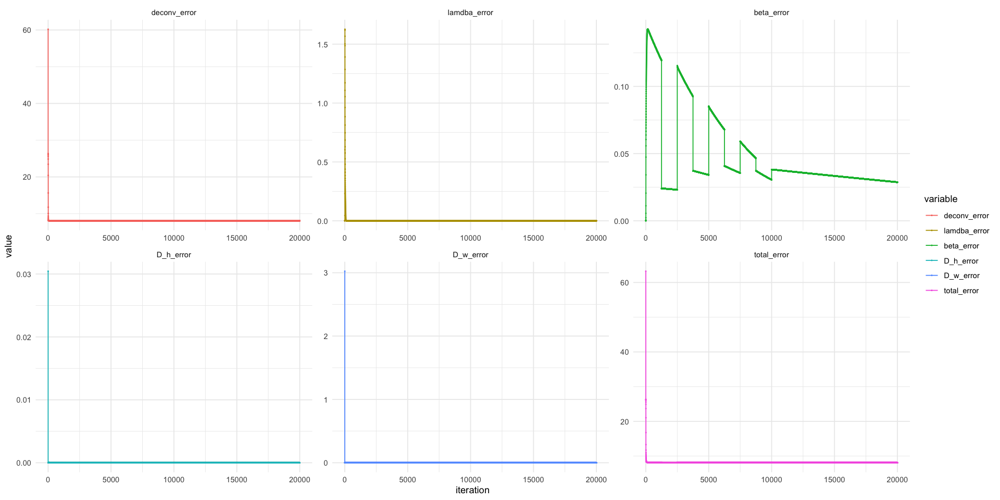

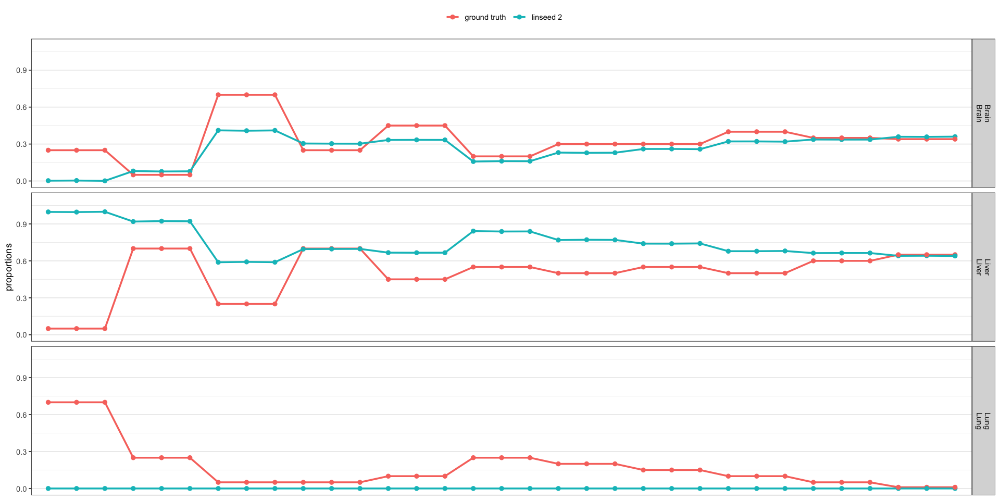

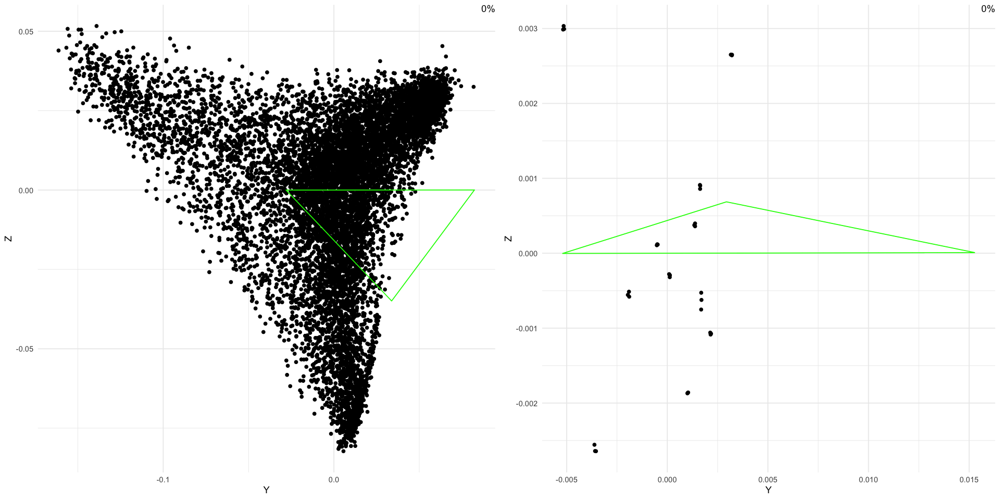

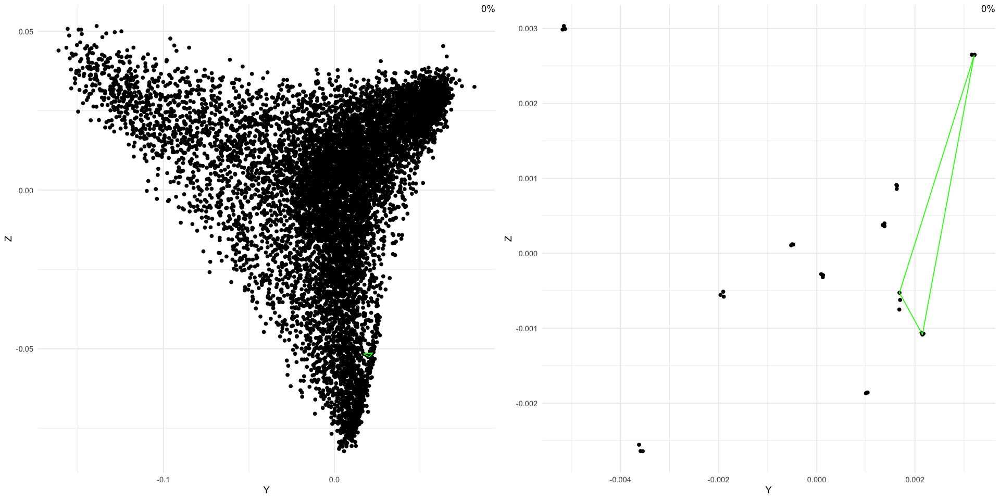

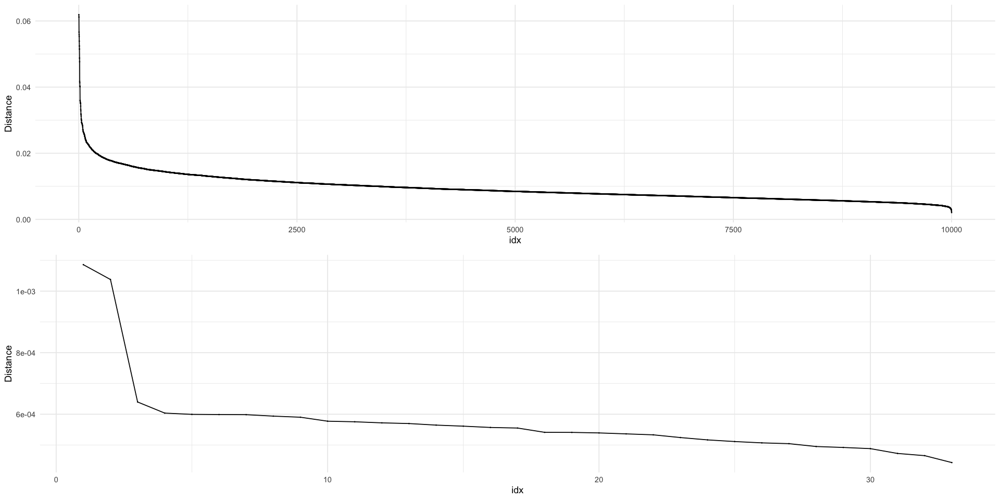

In [52]:
trainAndVisualizeLinseed2(global_iterations = 10000, top_genes = 10000, coef_hinge_W = 0.1, init_centered = FALSE)

# Simulation

In [32]:
sim.mix <- generateData(n_genes = 12000, n_samples = 300, n_cell_types = 3, noise_deviation = 2)

In [33]:
sim.props.true <- sim.mix$proportions

In [96]:
sim.lo <- fitDeconvolutionModel(edata = sim.mix$data, kind = "linseed", ntypes = 3, markers = sim.ml, TRUE)

In [ ]:
sim.props.lo <- sim.lo$proportions[guessOrder(sim.lo$proportions, sim.props.true),]
rownames(sim.props.lo) <- rownames(sim.props.true)
colnames(sim.props.lo) <- colnames(sim.props.true)

In [ ]:
plotProportions(sim.props.lo, sim.props.true, pnames = c("linseed 2", "ground truth"))

In [45]:
rmse(as.matrix(sim.props.lo), sim.props.true)

[1] 0.005537094

In [90]:
sim.lo2 <- trainLinseed2(sim.mix$data, 3, top_genes = 493)

[1] "Scale dataset"



Scaling dataset [=====>----------------------]  20% eta:  1s

Scaling dataset [======>---------------------]  25% eta:  1s

Scaling dataset [=======>--------------------]  30% eta:  1s

Scaling dataset [=========>------------------]  35% eta:  1s

Scaling dataset [==========>-----------------]  40% eta:  1s

Scaling dataset [============>---------------]  45% eta:  1s

Scaling dataset [=============>--------------]  50% eta:  1s

Scaling dataset [==============>-------------]  55% eta:  1s

Scaling dataset [================>-----------]  60% eta:  1s

Scaling dataset [=================>----------]  65% eta:  0s

Scaling dataset [===================>--------]  70% eta:  0s

Scaling dataset [====================>-------]  75% eta:  0s

Scaling dataset [=====================>------]  80% eta:  0s

Scaling dataset [=======================>----]  85% eta:  0s

Scaling dataset [========================>---]  90% eta:  0s

Scaling dataset [==========================>-]  95% eta:  0s

Scaling

[1] "Get SVD projections"
[1] "Find initial points"
[1] "Run optimization"


In [91]:
sim.lo2$saveResults()

In [92]:
tmp <- read.table(file = "./linseed2_results/markers_deconv_comparison_2_proportions.tsv")
sim.props.lo2 <- tmp[guessOrder(tmp, sim.props.true),]
rownames(sim.props.lo2) <- rownames(sim.props.true)
colnames(sim.props.lo2) <- colnames(sim.props.true)

In [93]:
options(repr.plot.width=16, repr.plot.height=8)

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


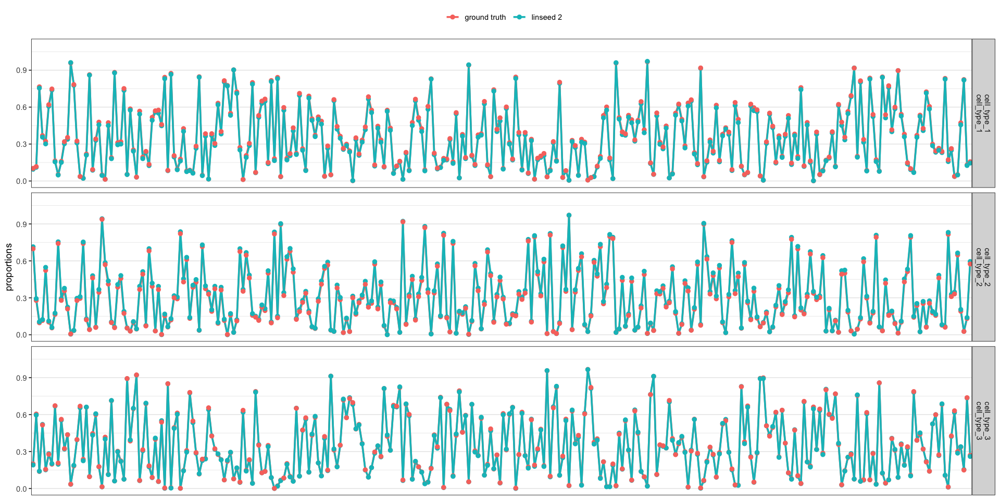

In [94]:
plotProportions(sim.props.lo2, sim.props.true, pnames = c("linseed 2", "ground truth"))

In [95]:
rmse(as.matrix(sim.props.lo2), sim.props.true)

[1] 0.01227272

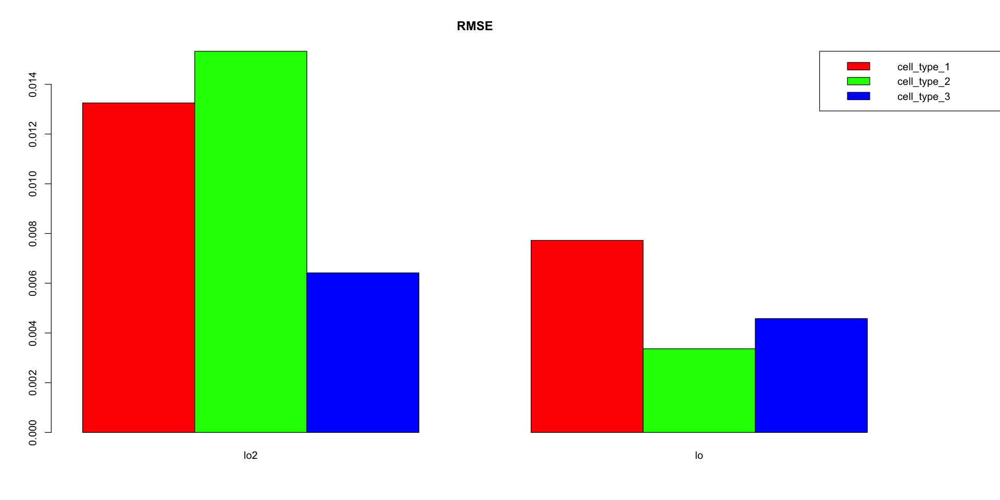

In [97]:
barplotMetric(
    predicts = list(lo2 = as.matrix(sim.props.lo2), lo = sim.props.lo),
    truth = sim.props.true,
    rmse,
    "RMSE",
    colors = c("red", "green", "blue")
)

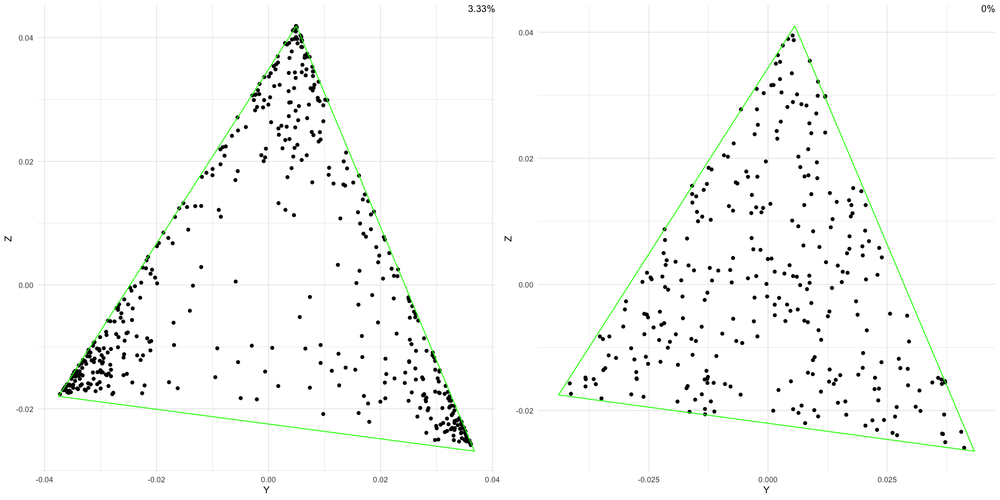

In [190]:
sim.lo2$plotPoints2D(points="current")

## Basis

In [195]:
tmp <- read.table(file = "./linseed2_results/markers_deconv_comparison_2_basis_fc_columns.tsv")
tmp <- tmp[2:nrow(tmp), c("Cell_type_1", "Cell_type_2", "Cell_type_3")]

In [50]:
sim.basis.true <- basis(sim.mix)[rownames(tmp),]

In [51]:
sim.basis.lo2 <- tmp[, guessOrder(t(tmp), t(sim.basis.true))]
colnames(sim.basis.lo2) <- colnames(sim.basis.true)

In [52]:
melted_basis <- meltPredictedAndActualBasis(sim.basis.lo2, log2(sim.basis.true))

Warning message in melt(dp, id.vars = "gene", variable.name = "tissue", value.name = "predicted"):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(dp). In the next version, this warning will become an error.”
Warning message in melt(da, id.vars = "gene", variable.name = "tissue", value.name = "actual"):
“The melt generic in data.table has been passed a data.frame and will attempt to redirect to the relevant reshape2 method; please note that reshape2 is deprecated, and this redirection is now deprecated as well. To continue using melt methods from reshape2 while both libraries are attached, e.g. melt.list, you can prepend the namespace like reshape2::melt(da). In the next version, t

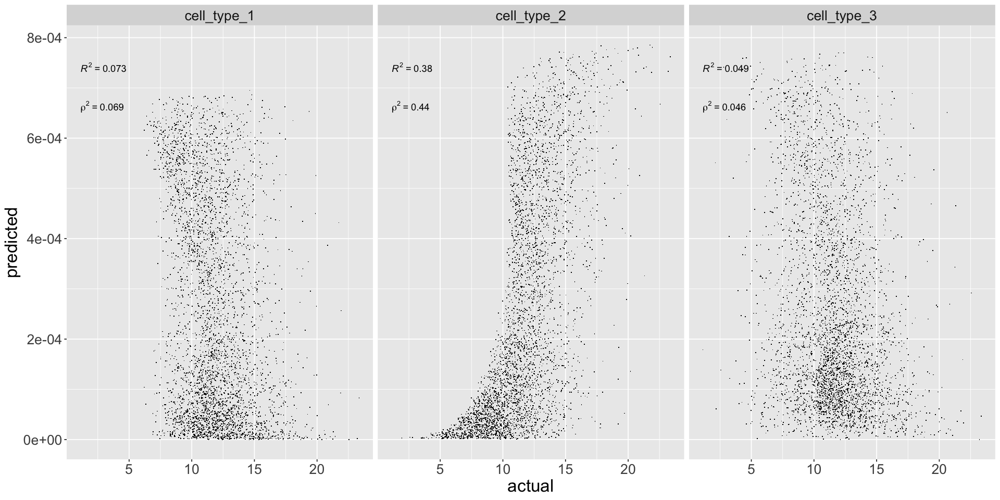

In [53]:
ggplot(melted_basis, aes(actual, predicted)) +
    geom_point(shape = ".") +
    stat_cor(method = "pearson", aes(label = ..rr.label..), label.y.npc = 0.95, cor.coef.name = "R") +
    stat_cor(method = "spearman", aes(label = ..rr.label..), label.y.npc = 0.85, cor.coef.name = "rho") +
    facet_wrap(vars(tissue)) +
    theme(text = element_text(size = 20))

In [54]:
sim.props.lo2

,sample_1,sample_2,sample_3,sample_4,sample_5,sample_6,sample_7,sample_8,sample_9,sample_10,⋯,sample_291,sample_292,sample_293,sample_294,sample_295,sample_296,sample_297,sample_298,sample_299,sample_300
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
cell_type_1,0.08342878,0.09816971,0.7209247,0.3262746,0.2756036,0.5704541,0.70427116,0.1386971,0.0407037,0.1347885,⋯,0.20801535,0.79598464,0.14108734,0.2265080,0.03049947,0.04122841,0.4226349,0.78735539,0.1113954,0.1294350
cell_type_2,0.72173658,0.29515835,0.1223510,0.1313965,0.5654246,0.1245546,0.07300959,0.1782114,0.7590481,0.2978657,⋯,0.08604083,0.08168242,0.84790500,0.3363756,0.34527124,0.66662641,0.2183934,0.04061783,0.1414912,0.6031396
cell_type_3,0.19483464,0.60667194,0.1567243,0.5423289,0.1589718,0.3049914,0.22271925,0.6830915,0.2002482,0.5673457,⋯,0.70594382,0.12233294,0.01100766,0.4371164,0.62422929,0.29214518,0.3589717,0.17202679,0.7471134,0.2674254


In [55]:
sim.props.true

,sample_1,sample_2,sample_3,sample_4,sample_5,sample_6,sample_7,sample_8,sample_9,sample_10,⋯,sample_291,sample_292,sample_293,sample_294,sample_295,sample_296,sample_297,sample_298,sample_299,sample_300
cell_type_1,0.10299,0.11692,0.76482,0.36896,0.32168,0.61983,0.74743,0.16256,0.05193,0.15923,⋯,0.23951,0.83316,0.17235,0.26343,0.03763,0.05203,0.47242,0.82375,0.13094,0.15619
cell_type_2,0.69762,0.27844,0.09701,0.11563,0.52273,0.10271,0.05538,0.16525,0.74110,0.27891,⋯,0.07714,0.06100,0.81561,0.30980,0.33118,0.64795,0.19095,0.02669,0.13165,0.57450
cell_type_3,0.19939,0.60464,0.13817,0.51541,0.15559,0.27746,0.19719,0.67219,0.20697,0.56186,⋯,0.68335,0.10584,0.01204,0.42677,0.63119,0.30002,0.33663,0.14956,0.73741,0.26931
